# Computer Vision

### **Why Computer Vision with Deep Learning Matters**

* **Rapid progress** in computer vision is powering applications like:

  * Self-driving cars (detecting cars and pedestrians)
  * Face recognition (unlocking phones, doors)
  * Personalized content (showing beautiful or relevant photos)
  * Generative art (e.g., neural style transfer)
* **Inspiration across domains**: Techniques from computer vision often influence other areas like speech recognition.


### **Core problems in computer vision**
* **Image classification**: Predicting the object in an image (e.g., is it a cat?).
* **Object detection**: Identifying and localizing multiple objects in an image (e.g., drawing bounding boxes around cars).
* **Neural style transfer**: Combining a content image with an artistic style to create stylized art.


### **Challenge with Vision: High-Dimensional Inputs**

* Images have huge input sizes:

  * A 64×64 RGB image has 12,288 features.
  * A 1000×1000 RGB image has 3 million features.
* Fully connected networks on large images result in **billions of parameters**, leading to:

  * **Overfitting risks**
  * **Excessive computation and memory use**


### **Solution: Convolutional Layers**

* To handle large images effectively, we use **convolutional operations**.
* Convolutions reduce the number of parameters and capture spatial structure in images.

# **Understanding the Convolution Operation in CNNs Using Edge Detection**

* **Convolution Basics**: The convolution operation is a core component of Convolutional Neural Networks (CNNs). It’s used to detect patterns in images.
* **Example – Edge Detection**:

  * Early layers in CNNs often detect simple features like **edges**.
  * Later layers build on these to detect more complex patterns, like **parts of objects** or **faces**.

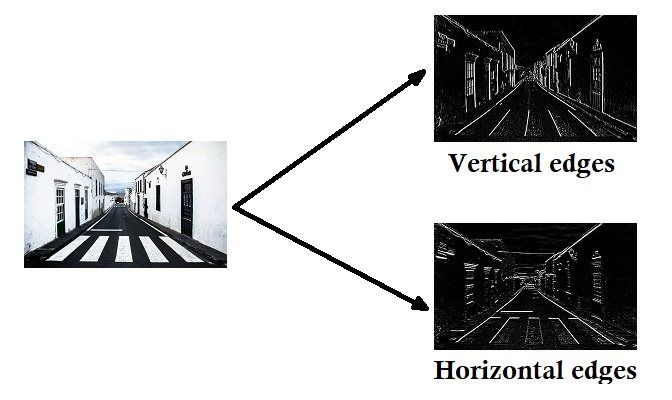


* **How It Works**:

  * Given a grayscale image (e.g., 6×6), you apply a small matrix (e.g., 3×3) called a **filter** (or kernel) to perform the convolution.
  * For horizontal edge detection, an example filter is:

    ```
    [ 1  1  1
      0  0  0
     -1 -1 -1 ]
    ```
  * This filter slides over the image, performing an **element-wise multiplication** at each location, and sums the result to produce a new value.
  * The result is a **smaller output matrix** (e.g., 4×4 from a 6×6 input) that highlights vertical edges.
  * The output represents how strongly the pattern defined by the filter (e.g., vertical edges) is present at each part of the image.

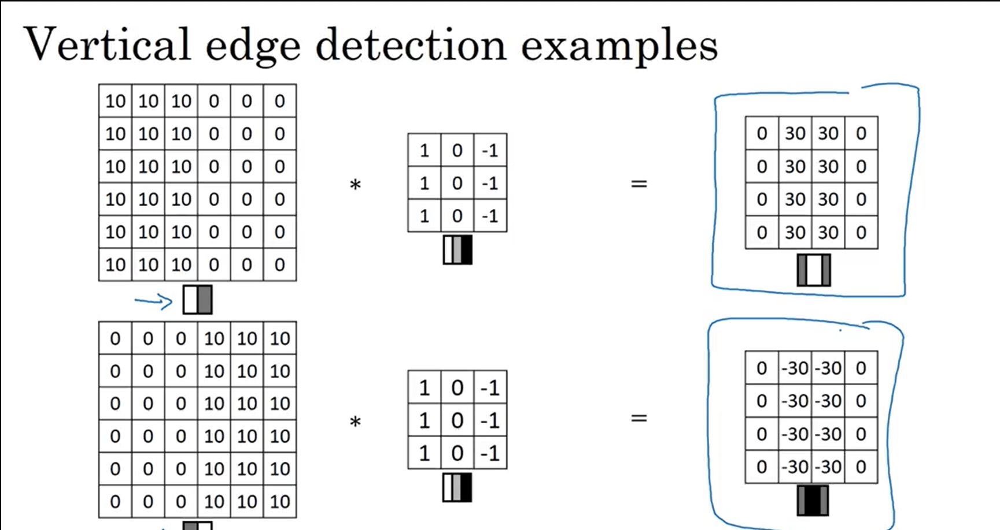


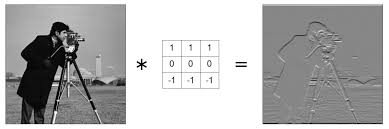


* **Example with Simplified Image**:

  * A 6×6 image with bright pixels (10) on the left and dark pixels (0) on the right has a clear vertical edge in the center.
  * Convolution with the vertical edge filter detects this edge and highlights it in the output.
  * The output matrix reflects the strength of edges, which can be visualized as a new image.


Here's a **summary** of the video content regarding convolution, edge detection, and learning filters:


### Why Convolutions Are Useful in Neural Networks:

Convolutional Neural Networks (CNNs) are powerful for image recognition due to **two main advantages** over fully connected networks:

1. **Parameter Sharing**:

   * The same filter (e.g., a vertical edge detector) is applied across different parts of the image.
   * This greatly reduces the number of parameters since one set of weights is reused.
   * It's based on the assumption that features useful in one part of an image are also useful elsewhere.

2. **Sparsity of Connections**:

   * Each output value depends only on a small local region of the input (e.g., a 3×3 patch), not the whole image.
   * This leads to fewer connections and, therefore, fewer parameters, making the model more efficient and less prone to overfitting.

### Example:

* A 32×32×3 image (3,072 input features).
* Applying six 5×5 filters results in a 28×28×6 output (4,704 features).
* A fully connected layer between them would need \~14 million parameters.
* A convolutional layer only uses 156 parameters (6 filters × (25 weights + 1 bias)) — massively fewer.

### Additional Benefit — **Translation Invariance**:

* CNNs naturally handle small shifts in the image (e.g., a cat moving slightly) due to the shared filters being applied everywhere.
* This makes CNNs robust and good at generalizing across different positions of features.


### **Other Types of Edge Detectors**

* **Horizontal Edge Detector**:
  A filter like:

  $$
  \begin{bmatrix}
  1 & 1 & 1 \\
  0 & 0 & 0 \\
  -1 & -1 & -1
  \end{bmatrix}
  $$

  detects transitions from top to bottom in brightness.

* **Sobel Filter** (e.g. for vertical edges):

  $$
  \begin{bmatrix}
  1 & 0 & -1 \\
  2 & 0 & -2 \\
  1 & 0 & -1
  \end{bmatrix}
  $$

  * Adds more weight to central rows/columns for robustness.

* **Scharr Filter**: A more refined version (e.g., `[3, 10, 3], [0, 0, 0], [-3, -10, -3]`), provides better edge detection in some cases.


### **Learning Filters with Neural Networks**

* Instead of hand-coding filters like Sobel or Scharr, deep learning allows **learning the filter weights** automatically.
* The **9 numbers** in a 3×3 filter are treated as **parameters**.
* Using **backpropagation**, the network learns the best filter values to detect meaningful features in the data.
* It can learn to detect:

  * Vertical, horizontal, and diagonal edges (e.g., 45°, 73°)
  * Or even patterns we don't have a name for
* This flexibility makes CNNs **powerful for feature extraction**.

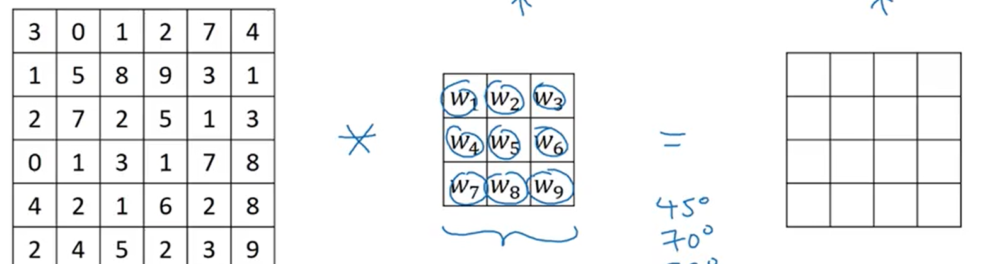


### Convolution Still at the Core

* Regardless of filter type, the **convolution operation** is the fundamental building block.
* Filters are applied across the entire image to build **feature maps**.
* The learning process replaces manual filter design with **data-driven optimization**.

# Padding

### **Problem Without Padding**

* Convolving an **n×n image** with an **f×f filter** reduces the output size:

  $$
  \text{Output size} = (n - f + 1) \times (n - f + 1)
  $$
* Example: 6×6 image with 3×3 filter → 4×4 output.
* **Two main downsides**:

  1. **Shrinking size**: Repeated convolution causes rapid shrinkage, limiting the depth of deep neural networks.
  2. **Edge information loss**: Corner/edge pixels influence fewer outputs than center pixels.


### **Solution: Padding**

* **Padding** adds a border (usually of zeros) around the image.
* If you **pad with *p* pixels**, the new image becomes:

  $$
  (n + 2p) \times (n + 2p)
  $$
* The new output size becomes:

  $$
  (n + 2p - f + 1) \times (n + 2p - f + 1)
  $$


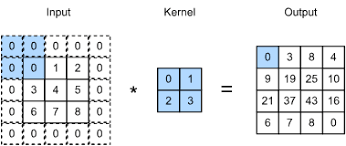


### **Preserving Output Size ("Same" Convolution)**

* To keep the output the same size as the input:

  $$
  n + 2p - f + 1 = n \Rightarrow p = \frac{f - 1}{2}
  $$
* This works when **f is odd** (which is almost always the case in computer vision).
* Example:

  * f = 3 → p = 1
  * f = 5 → p = 2


### **Types of Convolution**

1. **Valid Convolution**:

   * No padding: $p = 0$
   * Output shrinks: $n - f + 1$
2. **Same Convolution**:

   * Pad with $p = \frac{f - 1}{2}$
   * Output size = Input size


### **Why Filters Are Usually Odd-Sized**

* Avoids asymmetric padding (e.g., more on left than right).
* Allows a **central reference pixel** in the filter.
* Typical filter sizes: 3×3, 5×5, 7×7; sometimes 1×1.


### Final Notes

* You can **specify padding** by:

  * Giving a value for **p**
  * Using `"valid"` (no padding)
  * Using `"same"` (pad to preserve size)

# Strided convolution

* **Stride (s)** controls how much the filter “jumps” across the input image.
* **Stride = 1**: move the filter one pixel at a time (default).
* **Stride = 2**: move two pixels at a time → fewer steps → smaller output.

#### Example:

* Input: 7×7
* Filter: 3×3
* Stride: 2
* Output: 3×3
* Instead of sliding the filter over every adjacent position, it hops over by 2 pixels, reducing how many times convolution is applied.


### Output Dimension Formula (with stride & padding)

If:

* Input image size: $n \times n$
* Filter size: $f \times f$
* Padding: $p$
* Stride: $s$

Then:

$$
\text{Output size} = \left\lfloor \frac{n + 2p - f}{s} \right\rfloor + 1
$$

* **Floor** function ( ⌊ ⌋ ) means round down to the nearest integer.
* Applies separately to height and width if working with non-square inputs.

#### Note:

* The filter must **fully fit** within the padded image. If any part of the filter hangs off the edge, **that position is skipped**.


### Convolution vs. Cross-Correlation

* In **mathematics** or **signal processing**, *true* convolution involves:

  * Flipping the filter both **horizontally and vertically** before applying.
* In **deep learning**, we **skip this flipping step**.

  * So technically, it’s *cross-correlation*.
  * But it's still **called convolution** by convention.
* This distinction **doesn’t affect implementation or performance** in practice.


### Summary Points

* **Stride** reduces the size of the output by skipping positions.
* Use the output size formula to compute result dimensions.
* Use **flooring** when output size isn't an integer.

# 2D Convolution

Let’s break down the **2D convolution operation** step by step, including **formulas**, **dimensions**, and an **intuitive explanation** of how convolution works on 2D images.


## What is 2D Convolution?

2D convolution is a mathematical operation used to extract features (like edges, textures, corners) from an input image using a small matrix called a **filter** or **kernel**. This operation is the foundation of Convolutional Neural Networks (CNNs).


## Components of the Operation

### 1. **Input Image**

* A grayscale image is represented as a **2D matrix** of pixel values.
* Dimensions:

  $$
  I \in \mathbb{R}^{H \times W}
  $$

  where:

  * $H$: height of the image
  * $W$: width of the image

### 2. **Filter (Kernel)**

* A small matrix used to detect patterns like edges.
* Dimensions:

  $$
  K \in \mathbb{R}^{k_H \times k_W}
  $$

  where:

  * $k_H$: height of the filter
  * $k_W$: width of the filter

### 3. **Output (Feature Map)**

* The result of applying convolution, often called the **feature map** or **convolved feature**.
* Dimensions depend on the stride and padding used.


## The Convolution Formula (No Padding, Stride = 1)

Given:

* Input image $I \in \mathbb{R}^{H \times W}$
* Filter $K \in \mathbb{R}^{k_H \times k_W}$

Then the **output feature map** $O \in \mathbb{R}^{(H - k_H + 1) \times (W - k_W + 1)}$ is given by:

$$
O(i, j) = \sum_{m=0}^{k_H - 1} \sum_{n=0}^{k_W - 1} I(i + m, j + n) \cdot K(m, n)
$$

This equation means:

* Place the top-left corner of the filter on pixel $(i, j)$ of the image.
* Multiply overlapping elements.
* Sum the results to get the value at $O(i, j)$.


## Dimensions of the Output (General Case)

Let:

* $H, W$: Height and width of input image
* $k_H, k_W$: Height and width of filter
* $P$: Padding size (pixels added to border)
* $S$: Stride (step size of filter)

Then the output height and width are:

$$
H_{out} = \left\lfloor \frac{H + 2P - k_H}{S} \right\rfloor + 1
$$

$$
W_{out} = \left\lfloor \frac{W + 2P - k_W}{S} \right\rfloor + 1
$$

* **Padding (P)** adds zeros around the border to preserve dimensions.
* **Stride (S)** controls how far the filter slides at each step.


## Example

**Input image** $I \in \mathbb{R}^{6 \times 6}$
**Filter** $K \in \mathbb{R}^{3 \times 3}$
**Padding** $P = 0$, **Stride** $S = 1$

Output dimensions:

$$
H_{out} = \frac{6 - 3}{1} + 1 = 4
\quad \text{and} \quad
W_{out} = \frac{6 - 3}{1} + 1 = 4
$$

So output is $O \in \mathbb{R}^{4 \times 4}$


##  Intuition

When a filter moves over the image:

* It **focuses on a small region** (the same size as the filter).
* It **calculates a weighted sum** of the pixels in that region.
* It **outputs a single value** representing how much that region resembles the filter pattern.
* Repeating this for all positions gives the full output feature map.


## Extensions for Color Images

If the input image has **3 channels** (RGB), then:

* Image shape: $H \times W \times 3$
* Filter shape: $k_H \times k_W \times 3$
* The filter spans **all 3 channels**, and the element-wise multiplication includes all channels.

# 3D Convolution

### From 2D to 3D: Convolving RGB Images

* **RGB images** are 3D: width × height × **channels** (e.g., 6×6×3).
* Filters must match the **number of channels** in the input image (e.g., 3×3×3).
* You now convolve with a **3D filter** (not just 2D).


### How 3D Convolution Works

* A **3×3×3 filter** has **27 parameters** (9 per color channel).
* It slides across the image like a cube, matching across all 3 channels.
* At each step:

  * Multiply 27 numbers (filter × input patch)
  * Sum them up → gives **1 scalar output**
* Result: **2D output** (e.g., 4×4×1)


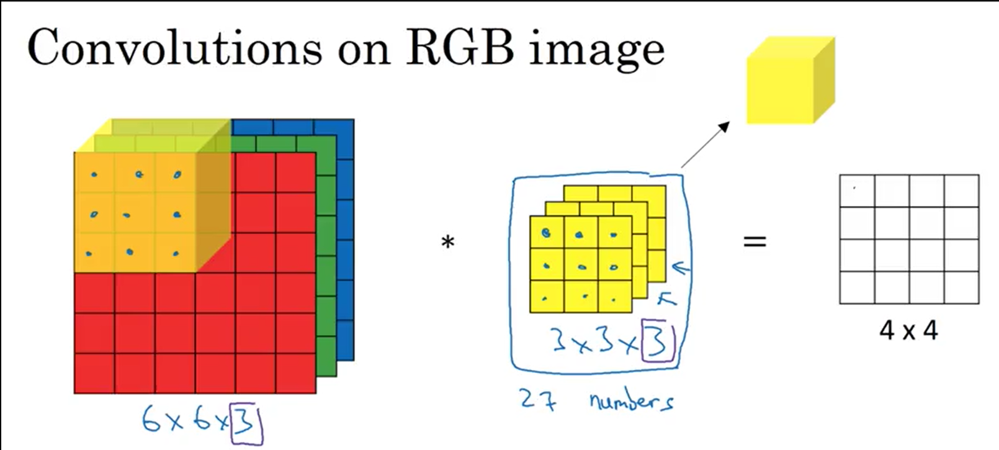


### Multiple Filters → Volume Output

* Instead of using just 1 filter:

  * Use multiple filters (e.g., 2 filters → vertical & horizontal edge detectors)
  * Each filter produces a **separate 2D output**
* Stack these outputs → **3D output volume**

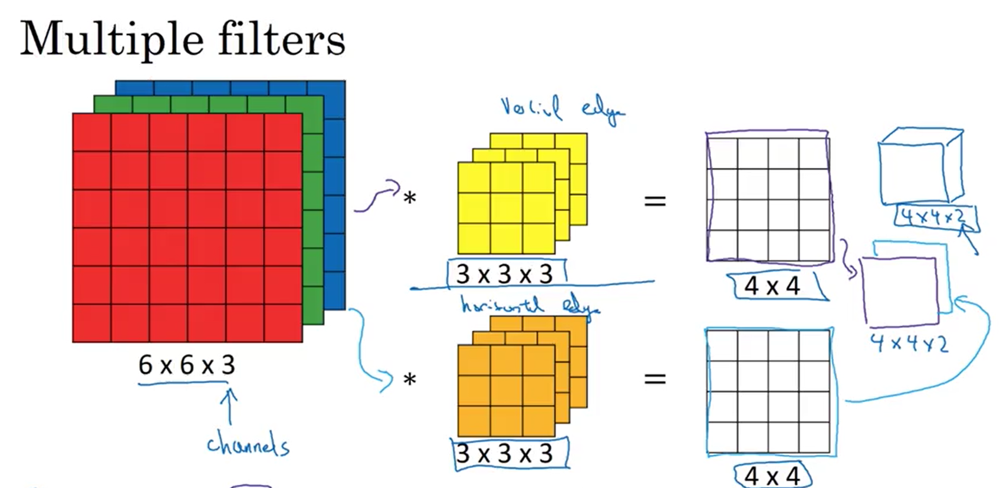


### Output Volume Dimensions:

Given:

* Input: $n \times n \times n_C$
* Filter: $f \times f \times n_C$
* Number of filters: $n_C'$

If:

* **Stride = 1**, **Padding = 0**

Then:

$$
\text{Output: } (n - f + 1) \times (n - f + 1) \times n_C'
$$


### Terminology

* **Channels** = depth of the image/filter in this context.
* Deep learning prefers using the term **channels** over **depth** (to avoid confusion with "depth of network").


### Why This Matters

* Enables applying CNNs to real-world images (e.g., color photos).
* Lets you detect **multiple types of features** at once (edges, textures, patterns, etc.).
* Each filter learns to detect a **different pattern**.
* Output has **as many channels as filters used**.

# One layer of a CNN


1. **Convolution**: The process involves convolving a 3D input volume (e.g., an image) with multiple filters to produce 4x4 outputs. Each filter gives a different output, and biases are added to each output. A non-linearity (e.g., ReLU) is applied to these outputs, resulting in the activation of that layer.

2. **Analogy to Neural Networks**: Convolution can be seen as a linear operation similar to matrix multiplication in standard neural networks, where each filter is analogous to weights in a fully connected layer. Adding a bias term and applying a non-linearity forms the activation.

3. **Output Dimensions**: After applying the filters, biases, and non-linearity, the output volume is determined. If you use multiple filters (e.g., 10 instead of 2), the output depth increases (e.g., 4x4x10).

4. **Parameter Calculation**: The number of parameters in the layer depends on the size of the filters, their depth, and the number of filters. For example, with 10 filters of size 3x3x3, the total number of parameters is 280 (including biases).

5. **Parameter Efficiency**: One key advantage of CNNs is that the number of parameters is fixed and relatively small, regardless of the input image size. This makes CNNs less prone to overfitting, as the number of parameters doesn't increase with larger images.

6. **Notations**:

   * **Filter Size**: Denoted as `f[l]` for the size of the filter in layer `l`.
   * **Padding**: Denoted as `p[l]`, referring to the amount of padding used.
   * **Stride**: Denoted as `s[l]`, referring to how the filter moves over the input.
   * **Input Dimensions**: The input to layer `l` has dimensions `n_h[l-1] x n_w[l-1] x n_c[l-1]`, where `n_h` is the height, `n_w` is the width, and `n_c` is the number of channels in the previous layer.
   * **Output Dimensions**: The output dimensions are computed based on the filter size, padding, stride, and input size.

7. **Channel Count**: The number of output channels is equal to the number of filters used in the layer.

8. **Weights and Biases**: Each filter has weights of size `f[l] x f[l] x n_c[l-1]`, and there is one bias for each filter.

9. **Consistency in Notation**: While different frameworks may use varying conventions (e.g., for the order of height, width, and channels), the main takeaway is understanding the operations of a single convolutional layer.

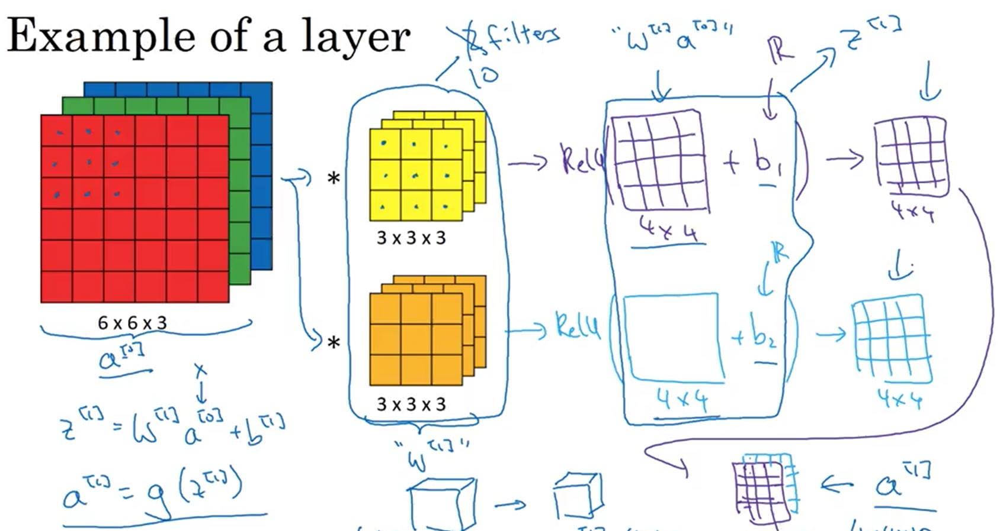


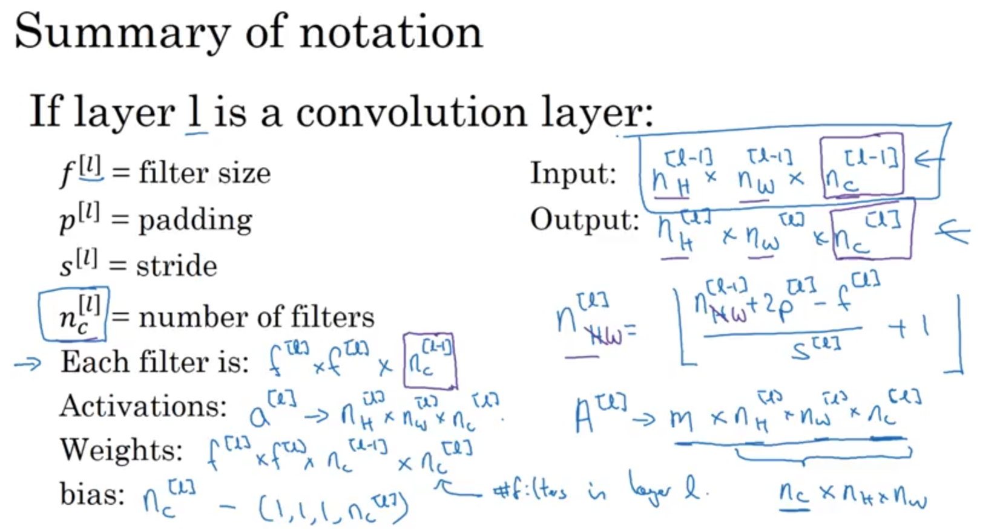


# Example of a simple CNN

1. **Task**: The goal is image classification (e.g., detecting if an image is a cat or not).

2. **Input**: An image of size **39 × 39 × 3** (height, width, color channels).

3. **Layer 1 (Conv Layer)**:

   * **Filter size**: 3×3
   * **Stride**: 1
   * **Padding**: None (valid convolution)
   * **Number of filters**: 10
     → **Output**: 37 × 37 × 10

4. **Layer 2 (Conv Layer)**:

   * **Filter size**: 5×5
   * **Stride**: 2
   * **Padding**: None
   * **Number of filters**: 20
     → **Output**: 17 × 17 × 20

5. **Layer 3 (Conv Layer)**:

   * **Filter size**: 5×5
   * **Stride**: 2
   * **Padding**: None
   * **Number of filters**: 40
     → **Output**: 7 × 7 × 40

6. **Flattening**:

   * The output volume **7 × 7 × 40** is flattened into a vector of size **1,960**.

7. **Classification**:

   * This vector is passed to a **logistic regression** or **softmax** unit for the final prediction.

8. **Design trends**:

   * As you go deeper in the network:

     * **Spatial dimensions** (height & width) **decrease**.
     * **Number of channels** **increases**.

# Pooling

### **Purpose of Pooling Layers**

* **Reduce spatial dimensions** (height & width) of feature maps.
* **Speed up computation** and reduce memory usage.
* **Introduce translation invariance** (make features more robust to small shifts).

The **intuition behind max pooling** is:

> **It retains the most prominent (strongest) feature in a local region.**

* In a feature map, large activation values typically mean a certain feature (like an edge, texture, or object part) was **detected**.
* Max pooling looks at small regions (e.g. 2×2 or 3×3) and keeps only the **maximum** value — meaning it keeps the **strongest signal**.
* This helps the network become more **robust to small translations** or shifts in the image. If a feature moves slightly within the pooling window, it will still be captured.

### Why it's useful:

* Reduces spatial dimensions — faster computation, less memory.
* Acts as a **form of downsampling**, while preserving key features.
* Helps prevent overfitting by reducing the number of activations.

### Example analogy:

Imagine you're scanning a small image patch for a "cat ear" feature. Even if the cat ear isn't in the same exact pixel in every image, as long as it shows up **somewhere in the pooling region**, max pooling will capture its presence.


### **Max Pooling Explained**

* Common pooling operation where each output value is the **maximum** of a region in the input.
* Example: A 4×4 input using **2×2 filter with stride 2** produces a **2×2 output**.
* Each 2×2 patch in the input is replaced by its max value.
* **Hyperparameters**:

  * `f` (filter size), e.g., 2
  * `s` (stride), e.g., 2
  * Padding `p` (rarely used in pooling, usually 0)

#### Example 2:

* 5×5 input with **3×3 filter, stride 1** produces a **3×3 output**.
* Computation is done independently for each channel when the input has depth.


### **Pooling on 3D Inputs**

* Applied **channel-wise**, preserving the number of channels.
* E.g., input: 5×5×2 → output: 3×3×2

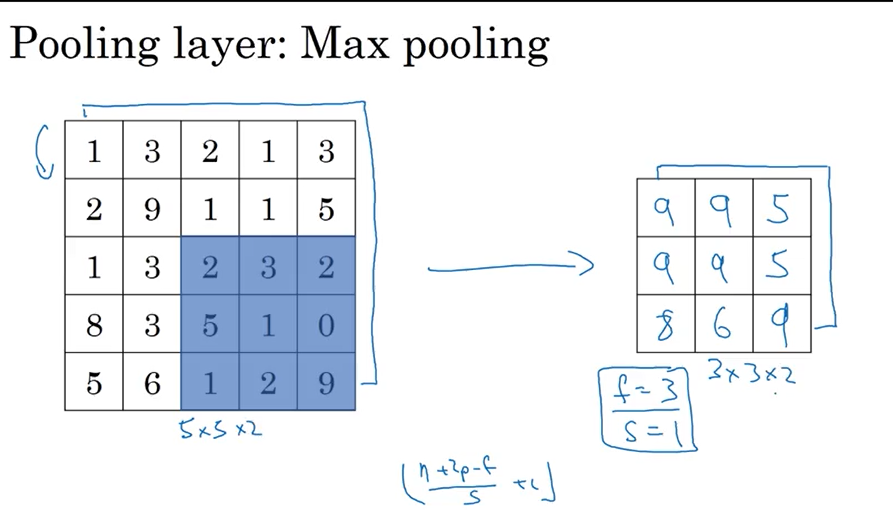

### **Average Pooling**

* Takes the **average** instead of the max in each region.
* Less common than max pooling, but sometimes used near the output layer (e.g., averaging a 7×7×1000 feature map to 1×1×1000).

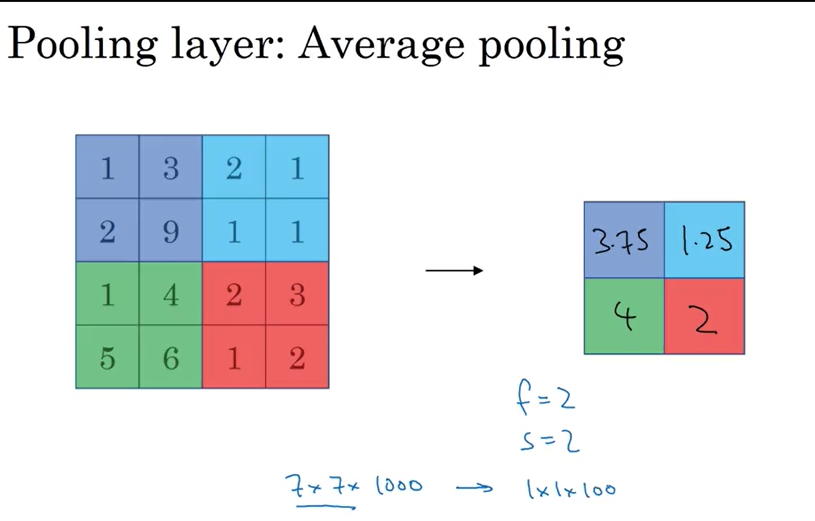

### **General Observations**

* **No parameters to learn** in pooling layers.
* Just hyperparameters to set (filter size, stride, type of pooling).
* Commonly used values: `f=2`, `s=2`, `p=0`.
* Pooling provides spatial downsampling while preserving important features.

# Example of a full CNN: LeNet-5

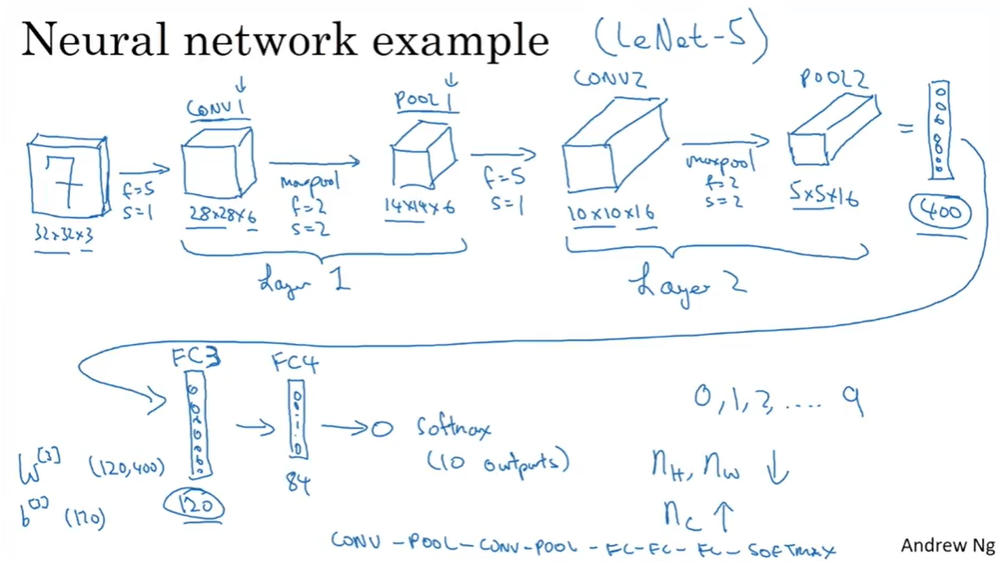

# AlexNet example of CNN

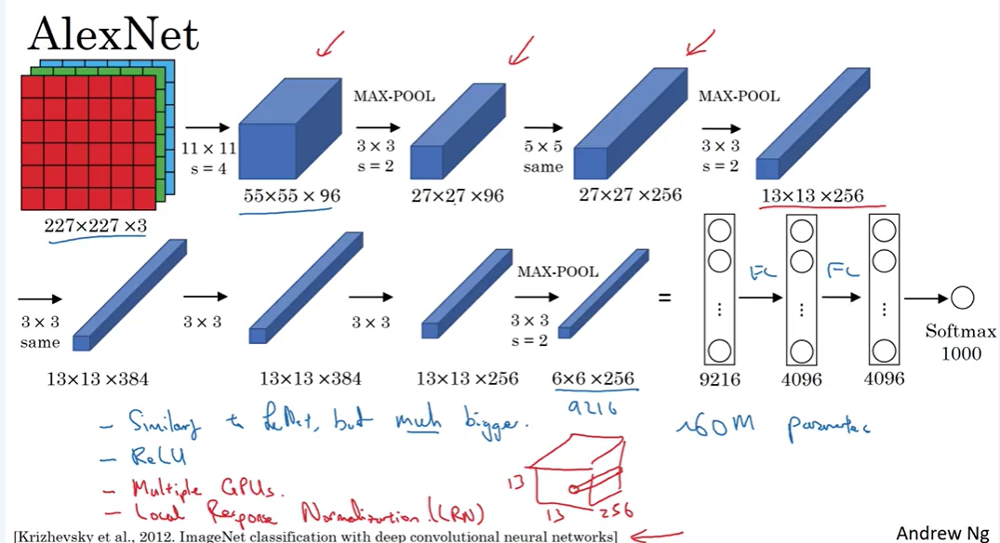

# VGG-16 CNN

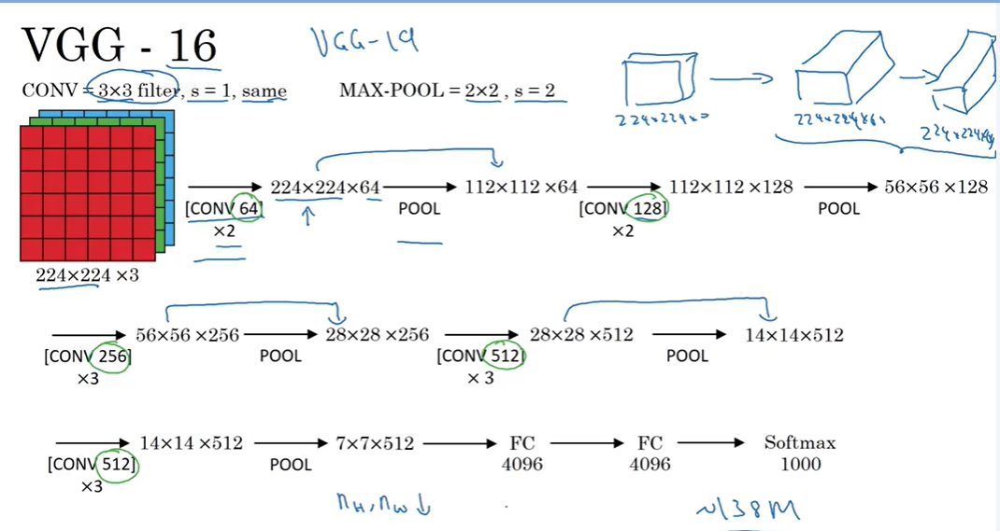

# Residual blocks and ResNets

A **residual block** is a fundamental building block of **ResNet** (Residual Network), a type of deep neural network architecture designed to solve the **degradation problem** that occurs when very deep networks perform worse than shallower ones. Let’s break it down comprehensively:


### **Problem It Solves: The Degradation Problem**

The **degradation problem** in deep neural networks refers to a surprising and counterintuitive phenomenon:

> As the number of layers in a deep network increases, **training accuracy** (not just test accuracy) **gets worse**, even though the network has more capacity to model the data.

You might expect that:

* A deeper network should at least perform **as well** as a shallower one, since it could **learn to mimic** the shallow one and then do more.

But in practice, this **doesn’t happen** due to optimization issues.

* After a certain depth (e.g., 30–40 layers), adding more layers leads to **higher training error**.
* The network **fails to converge to a better minimum**.
* **Accuracy degrades** as depth increases → hence the name "degradation problem".

This is **not caused by overfitting**, since training error also increases.

The deeper the network, the harder it is to:

1. **Propagate gradients** backward through many layers → **vanishing/exploding gradients**.
2. **Optimize**: Gradient-based optimization gets stuck or slowed in complex error surfaces.
3. **Learn identity mappings**: If some layers should ideally just pass inputs through, it's **hard for standard layers** to learn this.


### **Example from the ResNet Paper (2015)**

The authors show:

* A plain 56-layer CNN performs **worse** than a 20-layer version on CIFAR-10.
* This is true even on **training data**, which rules out overfitting.

They then propose **residual learning** to solve this.


### **Residual Connections Fix It**

Residual blocks allow the network to **learn identity functions easily**:

* If extra layers aren’t useful, the network can skip them (learn residual $F(x) = 0$).
* This avoids hurting performance by making depth "safe".

As a result, models like **ResNet-50, ResNet-101, and ResNet-152** become trainable and outperform shallower models.


### Core Idea

Instead of learning a function $H(x)$, the residual block learns the **residual**:

$$
F(x) = H(x) - x \quad \Rightarrow \quad H(x) = F(x) + x
$$

So, the block computes:

$$
\boxed{y = F(x) + x}
$$

Where:

* $x$ is the input to the block,
* $F(x)$ is the **residual function**, typically a few convolutional layers with ReLU activations and batch normalization,
* $y$ is the output,
* The term $x$ is added via a **skip connection** (also called a shortcut connection).


### **Mathematical Formulation**

Let’s define:

* $x \in \mathbb{R}^{d}$: input vector or feature map
* $F(x, W)$: residual mapping to be learned, with parameters $W$

Then:

$$
y = F(x, W) + x
$$

If $F$ is composed of two layers:

$$
F(x) = W_2 \sigma(W_1 x)
$$

Where $\sigma$ is an activation function (like ReLU), the output becomes:

$$
y = W_2 \sigma(W_1 x) + x
$$



* **Residual Block**:
  A typical ResNet block computes:

  $$
  a^{[l+2]} = g(z^{[l+2]} + a^{[l]})
  $$

  Instead of just:

  $$
  a^{[l+2]} = g(z^{[l+2]})
  $$

  Where:

  * $a^{[l]}$ is the input to the block
  * $z^{[l+2]}$ is the usual output from the main path (two linear + ReLU layers)
  * $g$ is the ReLU function
  * The term $a^{[l]}$ is added as a **shortcut connection**


Would you like a visual diagram of a residual block or the difference between plain and ResNet architectures?

### **Intuition**

Without a residual connection, the network has to directly learn $H(x)$. If the optimal mapping is close to the identity (i.e., $H(x) \approx x$), learning this can still be hard for a deep network.

With a residual connection:

* The network learns the **difference from the identity** (i.e., the residual).
* If nothing needs to be learned (optimal function is identity), it can easily set $F(x) = 0$, so $y = x$.

* In a standard deep network, **adding more layers** can hurt performance because it becomes **difficult to learn even the identity mapping**. This leads to the **degradation problem**.

* In contrast, a **residual block** lets the network learn:

  $$
  a^{[l+2]} = \text{ReLU}(z^{[l+2]} + a^{[l]})
  $$

  If the new layers learn **nothing useful**, the network can **default to copying the input** — i.e., learning the identity function is **easy** due to the skip connection.

* Even if the weights $W^{[l+2]}$ and bias $b^{[l+2]}$ shrink toward zero (e.g., via L2 regularization), the skip connection ensures:

  $$
  a^{[l+2]} \approx a^{[l]}
  $$

  So extra layers don’t hurt training performance — and **can only help if they learn something useful**.

* The network becomes like a **stack of identity functions + tweaks** (i.e., residuals).
* This is more stable for optimization, especially when using **ReLU** (which outputs non-negative values), helping avoid vanishing gradients.


✅ **Easier optimization**
✅ **Better gradient flow**
✅ **Allows very deep networks to train effectively**


## **Visualization**

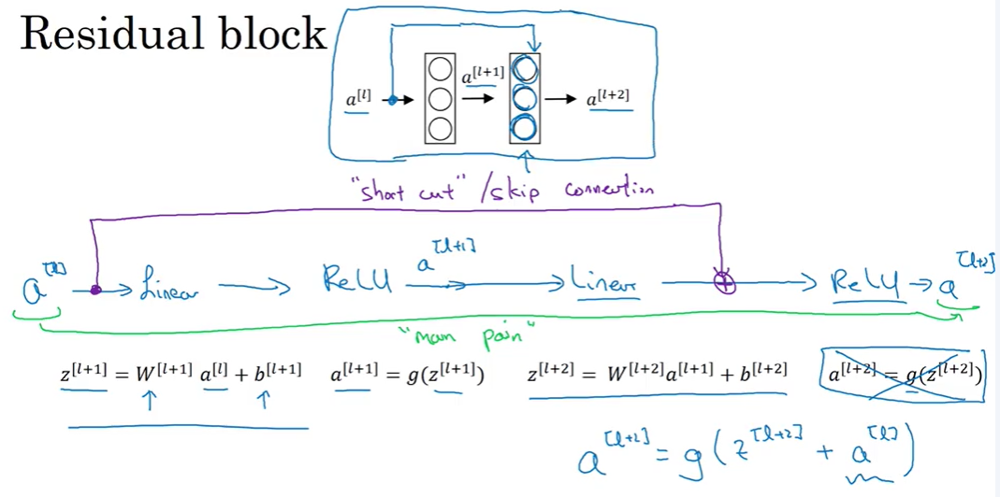


### **Variants**

1. **Identity block**: $x$ and $F(x)$ have the same dimensions → direct addition.
2. **Projection block**: $x$ and $F(x)$ differ in shape → use a linear projection $W_s x$ (1×1 convolution) to match dimensions:

   $$
   y = F(x) + W_s x
   $$
   

### **Key Benefits**

* **Stabilizes deep network training**
* **Improves gradient flow**
* **Enables deeper models** (e.g., ResNet-152)
* **Encourages feature reuse**


* **Why This Helps**:

  * Makes it easier for the network to learn the **identity function** if needed (i.e., just pass the input forward).
  * **Gradients** can flow backward more easily, which mitigates **vanishing gradients**.
  * Allows effective training of **very deep networks** — even those with **100+ layers**.

* **Plain vs Residual Network**:

  * A **plain network** stacks layers normally, without shortcuts.
  * A **ResNet** adds a skip connection every 2 layers, turning the architecture into a stack of **residual blocks**.

* **Empirical Result**:

  * Training error increases in plain networks as depth increases.
  * ResNets allow the training error to keep decreasing as the network grows deeper.

* **Conclusion**:
  ResNets revolutionized deep learning by enabling much **deeper models** that are **easier to train**, and more **accurate**. The key idea is simply: *"Let the model learn residuals rather than full transformations."*


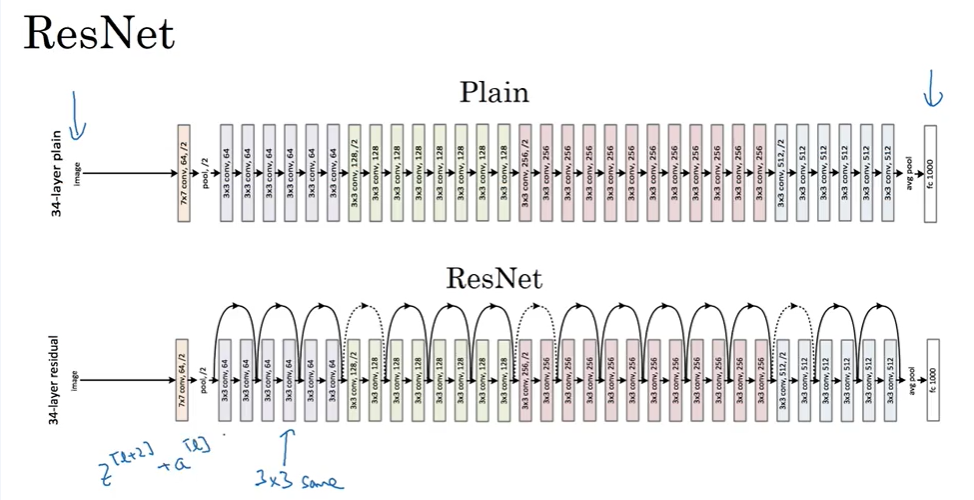

# 1x1 Convolution layer

* At first glance, a 1×1 convolution might seem trivial — like multiplying each pixel by a scalar.
* But when applied to **multi-channel inputs** (e.g., 6×6×32), it's **far more powerful**.

### **Core Idea**

* A 1×1 convolution:

  * **Processes all channels** at a single spatial location.
  * Learns a **weighted combination** of channel values.
  * Acts like a **fully connected layer** applied **independently** at each (height, width) position.
  * Includes **nonlinearity** (e.g., ReLU), making it non-trivial.

### Example:

For a 6×6×32 input and a 1×1 filter:

* The filter is 1×1×32.
* At each (h, w) location, it computes:

  $$
  y_{(h,w)} = \text{ReLU}(W \cdot x_{(h,w)} + b)
  $$
* This results in a 6×6×**1** output (per filter).
* Using **N** such filters gives output of shape 6×6×N.


### **Use Cases**

1. **Channel Reduction** (Dimensionality Reduction):

   * E.g., Convert 28×28×192 to 28×28×32 using 32 1×1 filters.
   * Reduces computation, memory usage, and overfitting.

2. **Adding Nonlinearity**:

   * Acts as a nonlinear transformation without changing spatial dimensions.

3. **Channel Expansion**:

   * Can also be used to increase the number of channels (e.g., to deepen the network).

4. **Used in Advanced Architectures**:

   * This idea, sometimes called **Network-in-Network** (from Lin et al.), influences:

     * **Inception Networks**
     * **SqueezeNet**
     * **MobileNet**

### Technical Detail:

* Input: H×W×C
* Filters: N filters of size 1×1×C
* Output: H×W×N


### Benefits

* **Computational efficiency** (no change in H or W).
* **Parameter efficiency** (especially compared to 3×3 or larger kernels).
* **Flexible control** over the **depth (number of channels)** of feature maps.


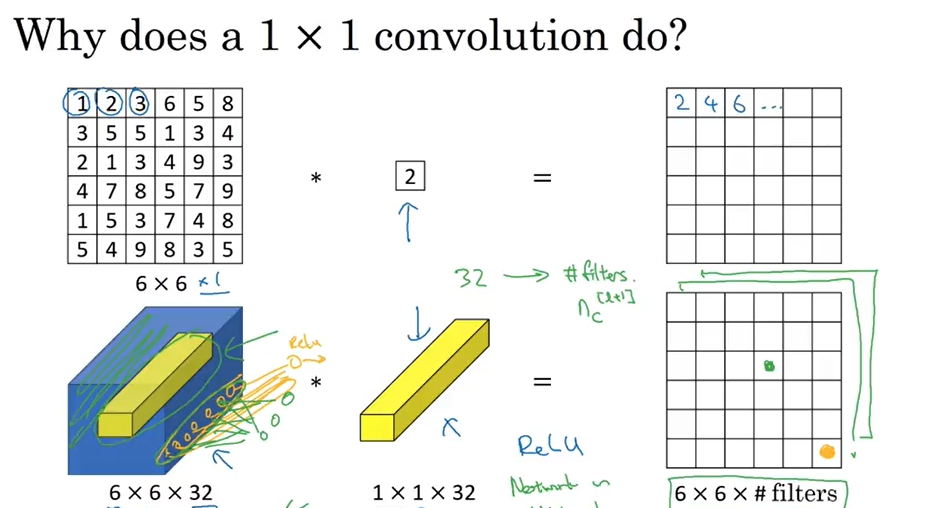


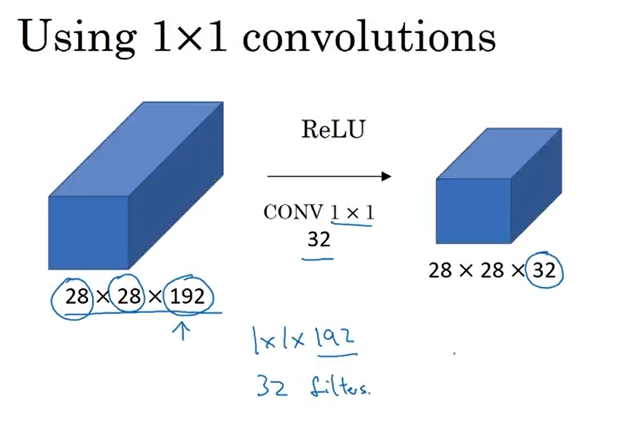


# Inception module for CNNs

### **Motivation**:

* Traditional CNNs require choosing a single filter size (e.g., 1×1, 3×3, 5×5) or pooling per layer.
* The **Inception module** says: **why choose one—use all** in parallel.

### **How it works**:

* Given an input volume (e.g., 28×28×192), apply in parallel:

  * 1×1 convolutions
  * 3×3 convolutions
  * 5×5 convolutions
  * Max pooling
* Use **"same" padding** and **stride 1** to keep spatial dimensions aligned (28×28).
* **Concatenate** all resulting volumes along the depth (channel) dimension to form the output (e.g., 28×28×256).

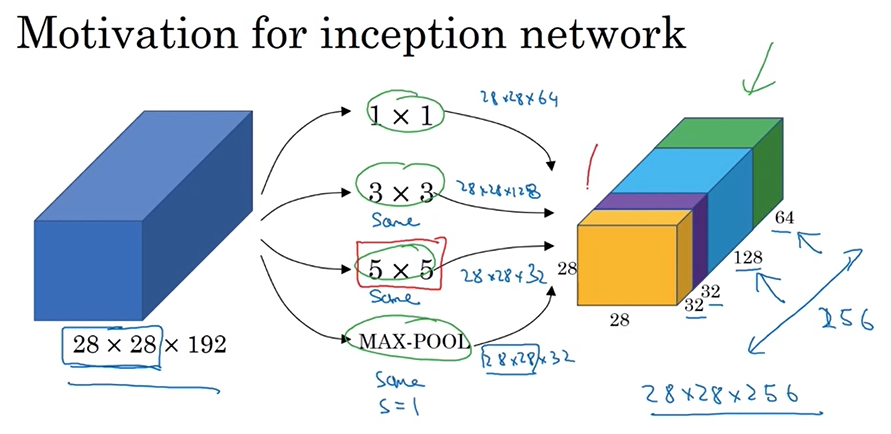


### **Problem**:

* Computational cost is high, especially for large filters (e.g., 5×5 with many input channels).

  * Example: 5×5 convolution with 192 input channels and 32 filters → \~120 million multiplications.


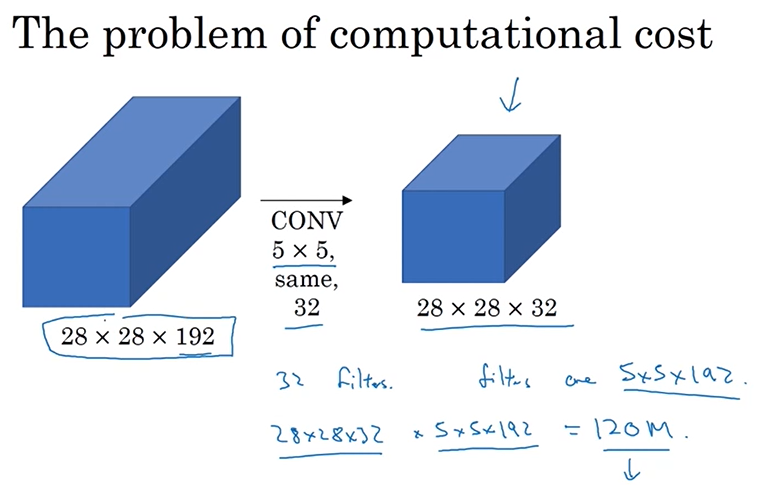


### **Solution – Bottleneck Layer**:

* Use a **1×1 convolution first** to reduce the number of channels before applying larger filters.

  * Example: Reduce 192 channels to 16 using 1×1 conv.
  * Then apply 5×5 convolution on the reduced volume → final output.
* This reduces computation dramatically:

  * From **120M → 12.4M multiplications** (\~10× reduction).

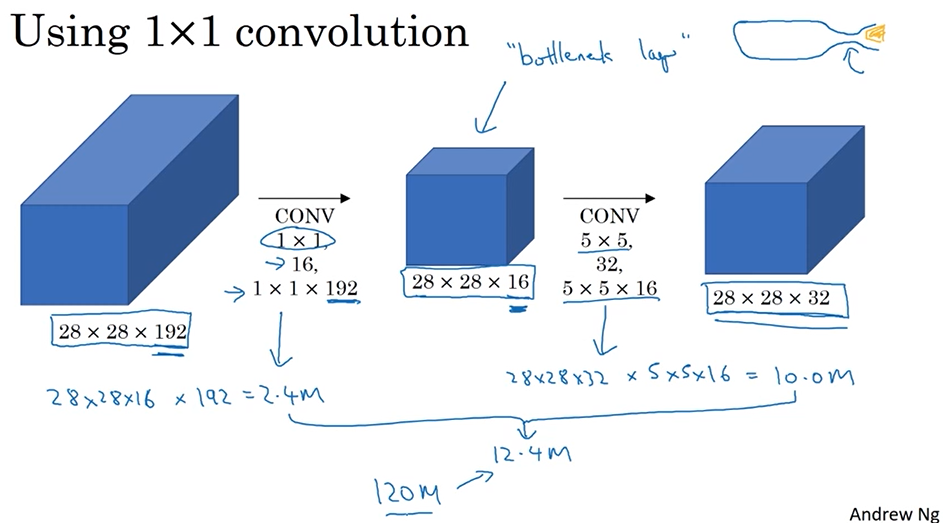


### **Does shrinking hurt performance?**

* Surprisingly, **no**—as long as the bottleneck layer is well-designed, performance remains high while saving resources.


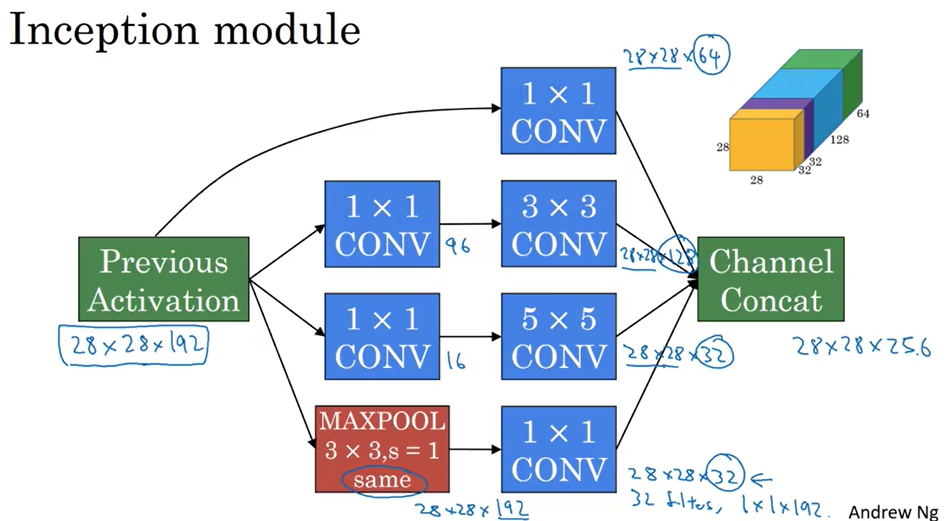


# The Inception CNN

The **Inception network** is built by stacking multiple **Inception modules**, each of which applies multiple convolution and pooling operations in parallel (e.g., 1×1, 3×3, 5×5 convolutions and max pooling), then **concatenates** their outputs along the depth (channel) dimension.

To reduce computational cost, especially for expensive convolutions like 5×5, each path often begins with a **1×1 bottleneck convolution** to reduce the number of input channels. This preserves output size but makes the computation more efficient.

A **typical Inception module** might consist of:

* 1×1 conv → output 64 channels
* 1×1 conv → 3×3 conv → output 128 channels
* 1×1 conv → 5×5 conv → output 32 channels
* 3×3 max pooling → 1×1 conv → output 32 channels
  Total output depth: 64 + 128 + 32 + 32 = **256 channels**

These modules are repeated to form the **full Inception network** (originally called **GoogLeNet**). The architecture also includes **auxiliary classifiers** (side branches with softmax outputs) attached to intermediate layers to provide regularization and improve training by encouraging early layers to learn meaningful features.


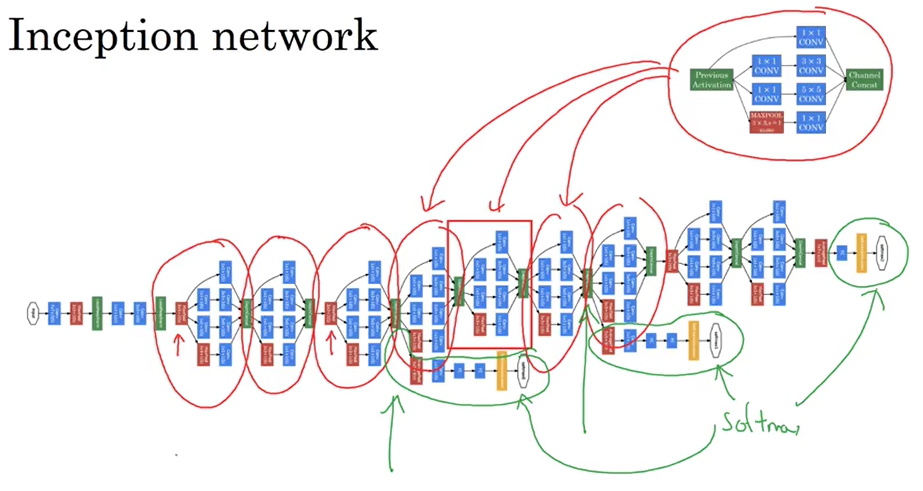

# **MobileNets & Depthwise Separable Convolutions Summary:**

MobileNets are efficient neural network architectures designed for deployment in low-compute environments like mobile devices. They achieve this efficiency by replacing standard convolutions with a **depthwise separable convolution**, which significantly reduces computational cost.

### **Standard Convolution:**

* Input: e.g., 6×6×3
* Filter: e.g., 3×3×3
* Output: e.g., 4×4×5 (no padding, stride = 1)
* Computational cost:
  $3×3×3$ (filter size) × $4×4$ (positions) × 5 (filters) = **2,160 multiplications**

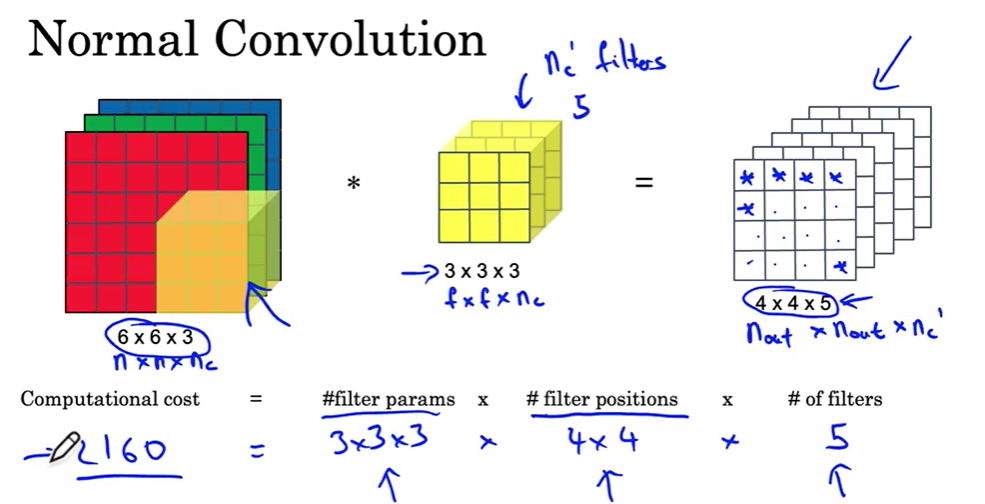

### **Depthwise Separable Convolution:**

Divides convolution into two steps:

1. **Depthwise Convolution:**

   * One 3×3 filter per input channel (3 filters total)
   * Output: 4×4×3
   * Cost:
     $3×3×4×4×3$ = **432 multiplications**

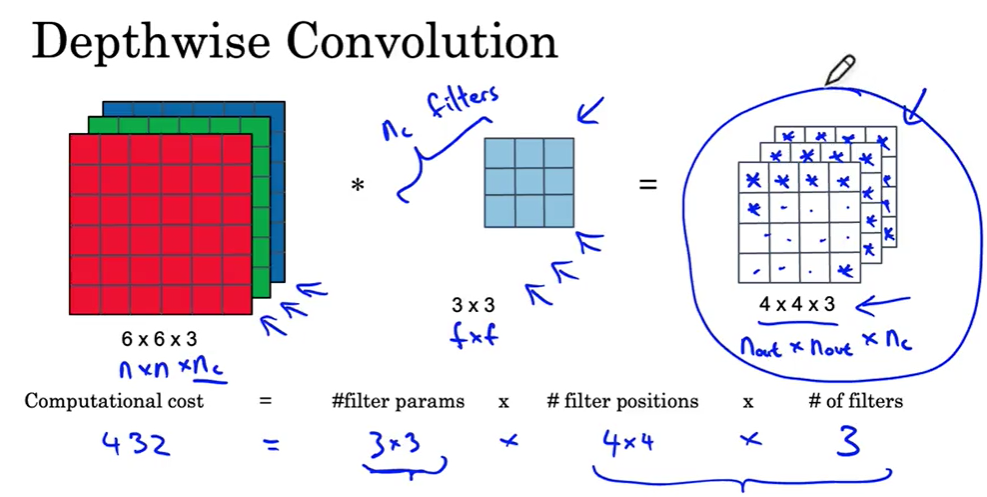

2. **Pointwise Convolution:**

   * Applies multiple 1×1×3 filters (e.g., 5 filters)
   * Output: 4×4×5
   * Cost:
     $1×1×3×4×4×5$ = **240 multiplications**

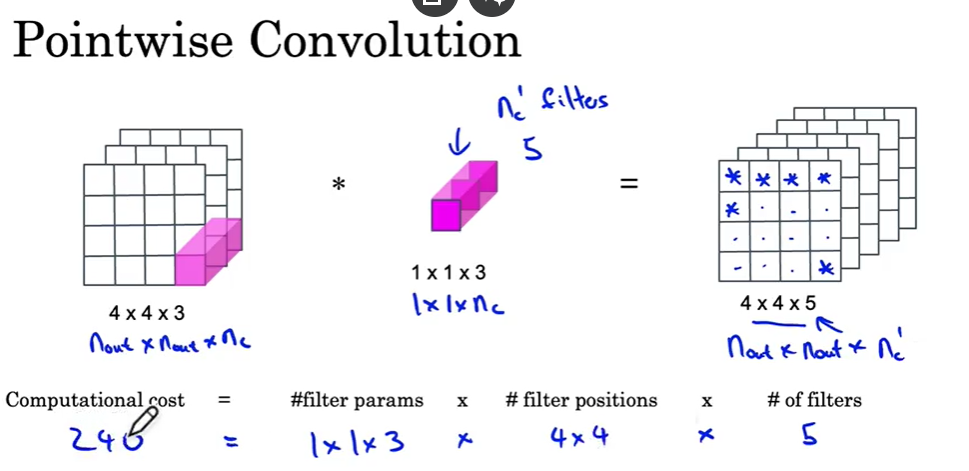

**Total for depthwise separable convolution:**
432 (depthwise) + 240 (pointwise) = **672 multiplications**

### **Efficiency Gain:**

* Depthwise separable convolution is about **31%** as expensive as standard convolution in this example.
* Theoretical cost reduction:
  $\frac{1}{n_c'} + \frac{1}{f^2}$
  For large $n_c'$, this can approach a **9–10× reduction** in compute.


**Conclusion:**
Depthwise separable convolutions are computationally efficient and form the core of MobileNets, making them ideal for real-time inference on mobile or embedded devices.

# MobileNet

* **Main Idea**: Replace expensive standard convolutions with depthwise separable convolutions (comprising depthwise and pointwise convolutions).
* **Structure**: The architecture consists of 13 blocks of depthwise separable convolutions followed by standard pooling, fully connected layers, and Softmax for classification.
* **Outcome**: This structure is computationally efficient and performs well in mobile environments.

### **MobileNet v2 Architecture:**

* **Improvements**:

  1. **Residual connections** (skip connections) for better backward propagation of gradients, similar to ResNet.
  2. **Expansion layer**: Before the depthwise separable convolution, a 1×1×n\_c filter is used to expand the input dimensions (e.g., from n×n×3 to n×n×18).
  3. **Bottleneck block**: The expansion is followed by depthwise separable convolution and a pointwise convolution (projection), which reduces the dimensionality back to n×n×3.
* **Bottleneck Block Explanation**:

  * **Expansion**: Increases the representation size, enabling the model to learn richer features.
  * **Pointwise convolution (projection)**: Reduces the size, conserving memory while maintaining rich computations.
* **MobileNet v2 Efficiency**: The bottleneck block helps MobileNet v2 improve performance by providing richer computations while still keeping memory requirements low.


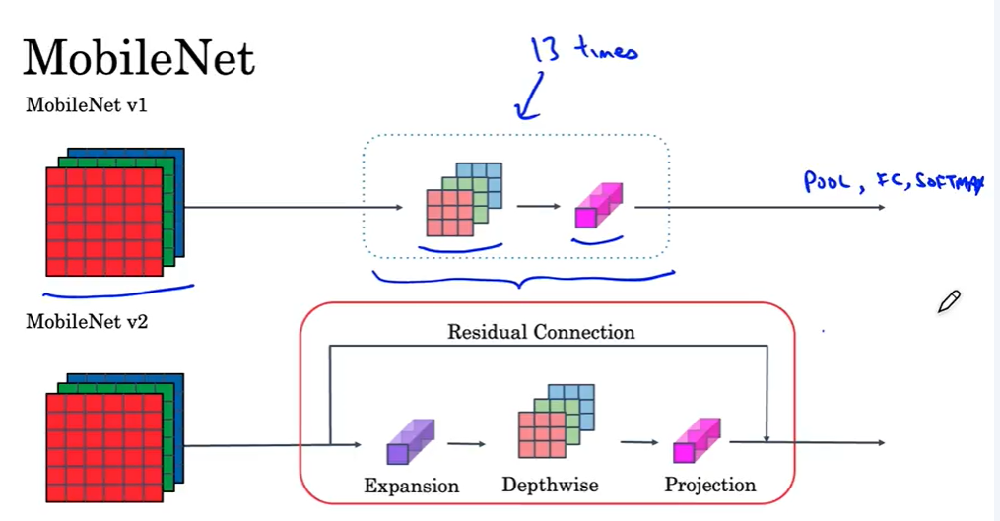


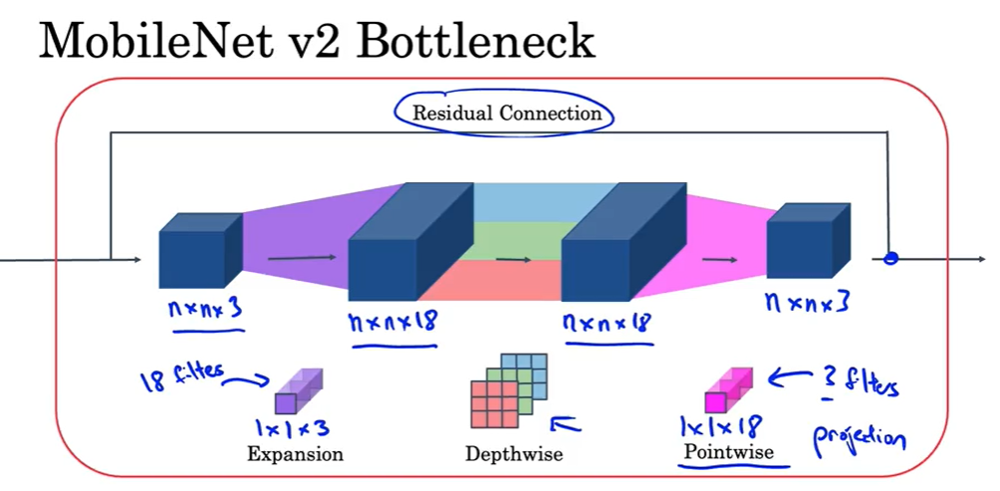


### **Comparison**:

* **MobileNet v1**: 13 depthwise separable convolution blocks.
* **MobileNet v2**: 17 bottleneck blocks (with residuals and expansions), making it more efficient while achieving better performance.


# EfficientNet

### **MobileNet Efficiency**:

* **MobileNet v1 and v2**: These architectures focus on computational efficiency by using depthwise separable convolutions and bottleneck blocks. However, there's still the challenge of tuning the architecture to work optimally on specific devices with varying computational resources.

### **EfficientNet: Scaling Neural Networks**:

* **Purpose**: EfficientNet helps scale neural networks automatically to fit the specific computational resources of a device. This is especially useful for mobile phones or edge devices with different levels of compute power.

* **Scaling Factors**:

  1. **Resolution (r)**: The size of the input image.
  2. **Depth (d)**: The number of layers in the network.
  3. **Width (w)**: The number of units per layer.

* **Compound Scaling**: EfficientNet introduces a technique called **compound scaling**, where these three factors (r, d, w) are scaled simultaneously in a balanced way, ensuring the network remains efficient across different devices.

### **Trade-off Between r, d, and w**:

* EfficientNet optimizes the trade-off between image resolution, network depth, and layer width to achieve the best performance for a given computational budget.
* Rather than arbitrarily increasing one factor (e.g., resolution), EfficientNet determines the optimal scaling for each factor to maximize accuracy without exceeding resource limits.

### **Implementation**:

* To adapt a neural network to a specific device, EfficientNet offers a method for selecting the best scaling strategy for r, d, and w. Open-source implementations of EfficientNet can be used to automate this process.

### **Conclusion**:

* With **MobileNet**, you can build efficient layers for mobile and embedded devices.
* **EfficientNet** allows you to intelligently scale the neural network’s complexity based on device resources, making it ideal for mobile and edge devices with memory and computation limitations.


With this understanding, you can now build neural networks that are both efficient and well-suited to the constraints of mobile and embedded devices.


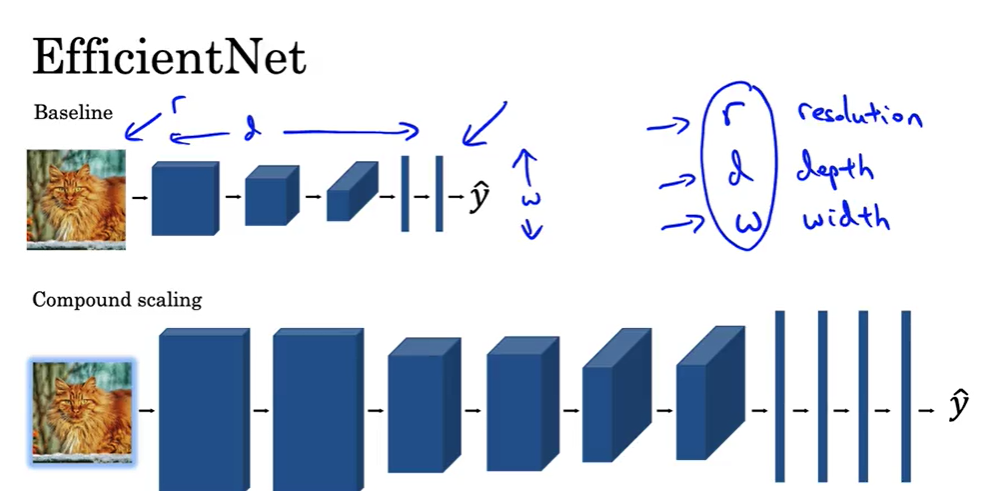

# Transfer Learning with CNNs

* **Transfer Learning**: Instead of training a neural network from scratch, you can make faster progress by using pre-trained models and their weights. These models are typically trained on large datasets (like ImageNet, MS COCO, etc.) and can serve as a good starting point for your task.

* **Example of Cat Detector**: If you're building a cat detector for your pets (e.g., Tigger and Misty), but don't have a lot of images, you can use a pre-trained model that was trained on a large dataset. For example, you could start with a model trained on ImageNet (which has 1,000 categories), then modify the output layer to predict "Tigger," "Misty," or "Neither." The rest of the layers are "frozen" (i.e., their weights are not updated), and only the new output layer is trained.

* **Freezing Layers**: You can freeze the weights of the earlier layers (which were trained on a large dataset) and only train the newly added layers. Many deep learning frameworks provide ways to freeze layers using parameters like "trainable = 0" or "freeze = 1."

* **Speeding Up Training**: To further speed up training, you can pre-compute and save the activations from the frozen layers, so you're not recalculating them every time during training. This allows you to focus training on the new softmax layer.

* **Training with More Data**: If you have a larger dataset, you can experiment with freezing fewer layers and training more layers of the network. With more data, you might also train a more complex network (with additional layers) instead of just training the softmax layer.

* **Full Network Fine-Tuning**: If you have a large enough dataset, you can fine-tune the entire pre-trained network, adjusting all layers. You would replace the output layer to match the classes you care about (e.g., Tigger, Misty, and Neither).

* **When to Use Transfer Learning**: In practice, because pre-trained models have been trained on large, open-source datasets and have learned valuable features, transfer learning is often the best approach, especially when you have limited data or computational resources. It's highly recommended unless you have an exceptionally large dataset and a large computational budget to train from scratch.


Transfer learning makes it much easier to leverage pre-existing knowledge from large datasets and significantly improves your model's performance, especially when you're dealing with small datasets or resource constraints.


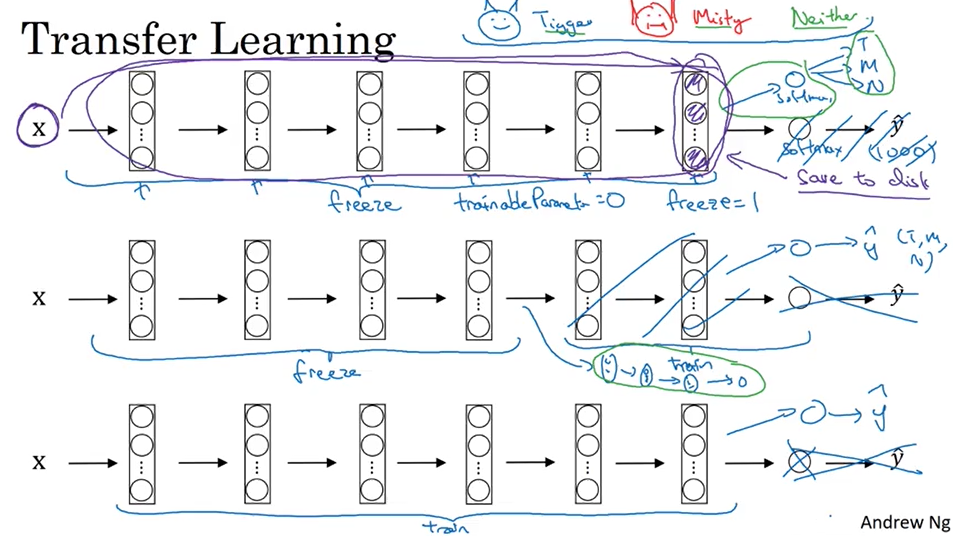

# Data Augmentation for Computer Vision

* **Need for More Data**: In computer vision, having more data generally leads to better model performance. Since computer vision tasks often require complex models to understand images, increasing the dataset can significantly improve results. Data augmentation is a technique used to artificially expand a dataset by creating modified versions of existing images.

* **Common Data Augmentation Techniques**:

  1. **Mirroring**: Horizontal flipping of images is a simple and effective augmentation, especially when the mirrored image still represents the same class (e.g., a cat will still be a cat when flipped).

  2. **Random Cropping**: Randomly selecting subregions of an image to crop and use as separate training examples. This introduces variation in the training data but can cause issues if the cropped section doesn’t represent the target object well.

  3. **Rotation, Shearing, and Warping**: These more advanced techniques distort the image (e.g., rotating, stretching, or bending), though they are used less frequently due to their complexity.

  4. **Color Shifting**: Altering the color channels (Red, Green, Blue) to simulate different lighting conditions or color distortions. For example, adjusting the RGB values can simulate a yellowish hue or a more blueish tone. This makes the model more robust to color variations.

  * **PCA Color Augmentation**: A more advanced method for color shifting that uses Principal Component Analysis (PCA) to balance the color distribution and maintain the overall color "tint" of the image.

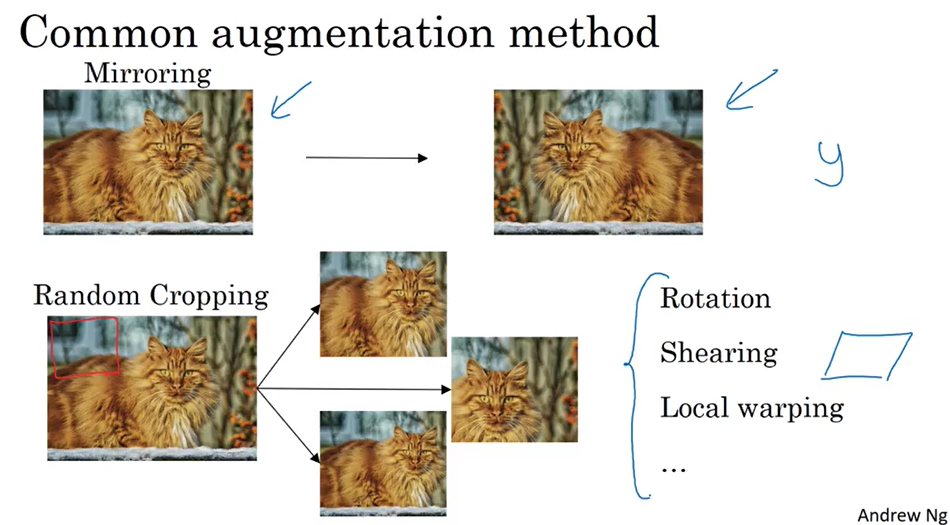


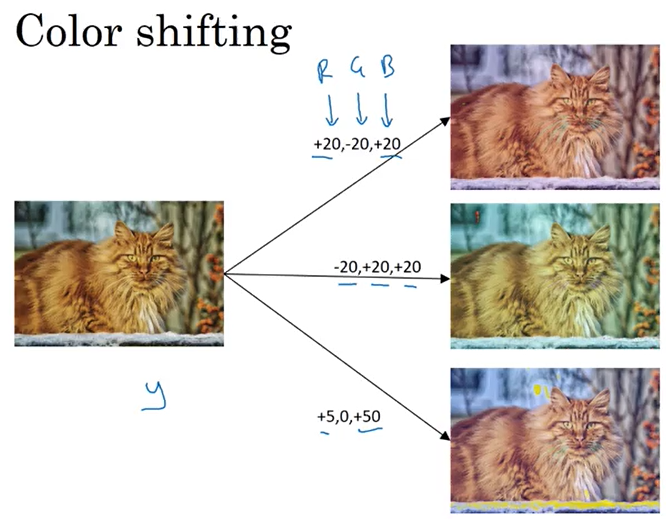


* **Implementation**:

  * Data augmentation is typically implemented by using a CPU thread that loads images from disk and applies augmentations (like cropping, mirroring, color shifts) before sending the modified images to the GPU for training.
  * This allows data augmentation and model training to happen in parallel, optimizing efficiency.

* **Hyperparameters**: Augmentation methods like color shifting and cropping come with hyperparameters (e.g., how much color shifting to apply or how large the crop should be). It's often useful to experiment with different settings or use open-source implementations as a baseline.

* **Using Augmentation in Practice**: To improve performance, you can start by using pre-existing implementations of data augmentation. However, if your dataset has specific characteristics or requirements, it might be worth adjusting the hyperparameters or developing custom augmentation methods.


**Conclusion**: Data augmentation is a vital technique in computer vision, particularly when dealing with limited data. It helps make the model more robust by introducing variations, such as changes in image orientation, color, or cropping. Properly tuning the data augmentation methods can lead to significant improvements in model performance.


# State of Computer Vision

* **Deep Learning's Success**: Deep learning has shown great success in a variety of fields, including computer vision, natural language processing, and speech recognition. However, the application of deep learning to computer vision has unique challenges and characteristics.

* **Data Availability**: In many machine learning tasks, having more data generally leads to better performance. While speech recognition has sufficient data, computer vision, particularly tasks like image recognition, often feels data-starved despite large datasets. Object detection, which involves identifying objects and placing bounding boxes around them, suffers even more due to the cost and difficulty of labeling data.

* **Hand-Engineering vs. Large Data**: When there is less data, more "hand-engineering" (manual design of features and network architectures) is needed. In contrast, when there is a lot of data, neural networks can learn complex patterns without extensive manual intervention. Historically, computer vision relied heavily on hand-engineering due to smaller datasets, but as data availability has increased, the reliance on hand-engineering has decreased, though complex network architectures still remain common.

* **Role of Transfer Learning**: Transfer learning is particularly useful when data is limited. By leveraging pre-trained models and fine-tuning them on specific tasks, it’s possible to get good results with less data.

* **Benchmarking and Competition**: The computer vision community is enthusiastic about performing well on benchmark datasets and competitions. However, techniques used to excel in these benchmarks (e.g., ensembling and multi-crop testing) are not always practical for real-world production systems. These methods can improve performance slightly on benchmarks but significantly increase computation time and resource usage, making them less suitable for deployment.

  * **Ensembling**: Involves training multiple models and averaging their predictions to improve performance slightly. However, it significantly increases the computational cost.

  * **Multi-Crop Testing**: Involves cropping test images in several ways and averaging the results. While it can improve performance, it also requires much more computational power.

* **Practical System Building**: For real-world applications, using pre-trained models and fine-tuning them on your specific data is often more practical and efficient than training a new model from scratch. Open-source implementations can save time and effort, as they have fine-tuned many aspects, such as hyperparameters. However, if you have the necessary resources, training from scratch can be a valid option.

* **Computer Vision Challenges**: Computer vision tasks, particularly in smaller data regimes, still require a lot of experimentation with network architectures. It's often effective to start with well-established models from the community to build practical, deployable systems quickly.

---

**Conclusion**: Deep learning has transformed computer vision, but the field still faces challenges such as data scarcity and the complexity of designing effective models. While modern techniques like transfer learning and pre-trained models can ease these challenges, methods to optimize performance for benchmarks may not always translate well to real-world applications.



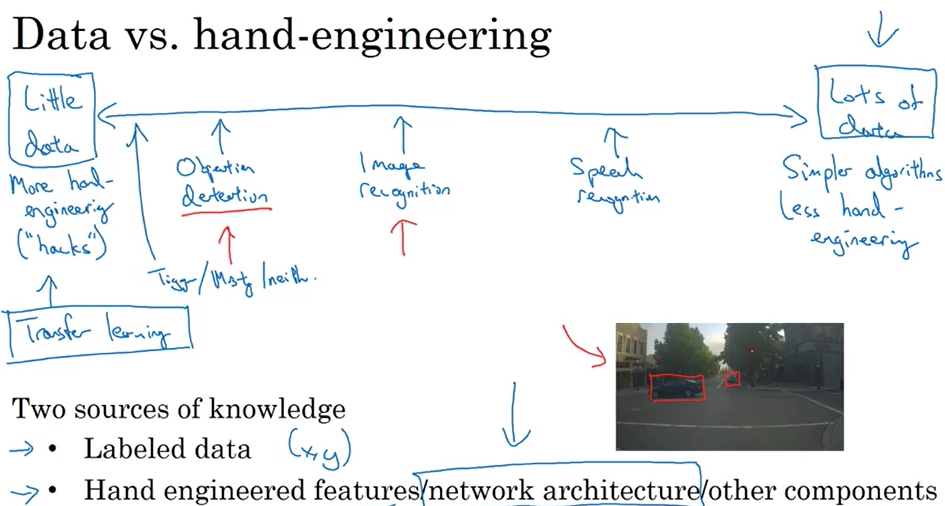

# Object Localization

* **Object detection** is a fast-growing area in computer vision with significantly improved performance in recent years.

* **Image Classification**: Identify the main object in an image (e.g., a car).
* **Classification with Localization**: Identify the object *and* draw a **bounding box** around it.
* **Detection**: Identify and localize **multiple objects** of possibly different classes in a single image.

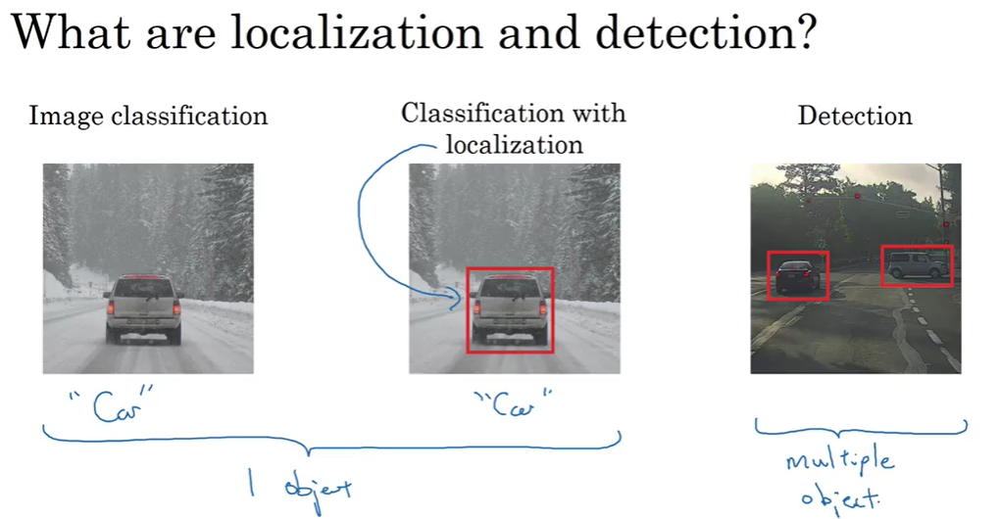

### Network Outputs for Localization**

* Extend the classifier to output:

  * **pc**: probability an object is present.
  * **bx, by**: bounding box center coordinates.
  * **bh, bw**: bounding box height and width.
  * **c1, c2, c3**: class probabilities (e.g., pedestrian, car, motorcycle).

* If **no object**, set `pc = 0` and the rest of the values are ignored.

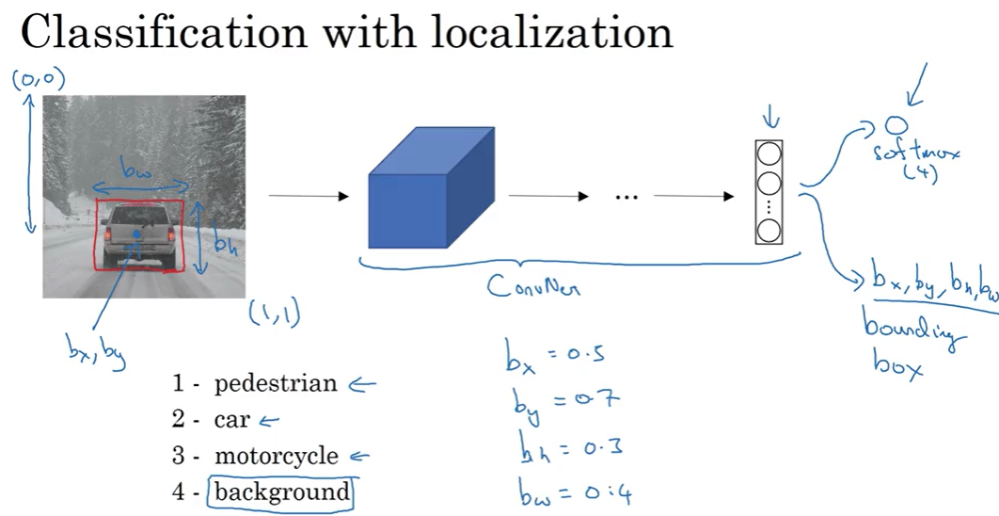


### Coordinate Conventions**

* Coordinates range from (0,0) in the **top-left** to (1,1) in the **bottom-right** of the image.
* Bounding boxes are defined by **center (bx, by)** and **size (bh, bw)**.

### Target Label Format**

Each training label **y** has 8 elements:

* **$pc, bx, by, bh, bw, c1, c2, c3$**


### Loss Function**

* If **pc = 1** (object present): Use **squared error loss** over all 8 components.
* If **pc = 0** (no object): Only penalize the error in **pc**.
* In practice:

  * Use **cross-entropy** for class probabilities.
  * Use **logistic loss** for pc.
  * Use **squared error** for bounding box coordinates.

# Landmark detection

Landmark detection is a **computer vision task** that involves detecting key **points of interest (landmarks)** on an object within an image—typically used in **face analysis, pose estimation, medical imaging, and augmented reality**. Below is a detailed explanation of the **concept**, how to **perform** it, and how to **implement** it in practice.

* A **landmark** is a specific point on an object that is **semantically meaningful**.

  * Example (face): corner of the eye, tip of the nose, mouth corners.
  * Example (human pose): shoulders, elbows, knees.

### Why Is It Useful?

### Applications of Landmark Detection**

* **Face Recognition / Analysis**

  * Output a point like the **corner of the eye** → 2 numbers: `lx`, `ly`.
  * For **both eyes**, use `l1x`, `l1y`, ..., `l4x`, `l4y`.
  * For **full facial geometry**: maybe 64 points → **128 outputs (64 x-coordinates + 64 y-coordinates)**.
  * Also include a binary output (e.g., `pf`) for face presence → **total 129 outputs**.

* **Emotional Recognition / AR Filters**

  * Detect **mouth shape**, **jawline**, **eye corners**, etc.
  * Key for **augmented reality** effects (e.g., Snapchat filters like adding a crown or hat).

* **Human Pose Detection**

  * Define landmarks for joints: **chest, shoulders, elbows, wrists**, etc.
  * Output X, Y coordinates for each keypoint (e.g., 32 points → 64 outputs).

* **Gesture recognition**
* **Medical image analysis**


## How Landmark Detection Works

### **Input**

* An image (typically preprocessed and resized)

### **Model Output**

* A vector of **(x, y)** coordinates representing landmark positions.

  * For `n` landmarks: output is a vector of length `2n`:

    $$
    \hat{y} = [l_1^x, l_1^y, l_2^x, l_2^y, ..., l_n^x, l_n^y]
    $$

### **Supervised Learning**

* Requires a labeled dataset:

  * Each image has the **ground truth (x, y) coordinates** of each landmark.
  * Important: The landmark ordering must be **consistent** across images.

### **Loss Function**

* Typically **Mean Squared Error (MSE)** between predicted and ground-truth coordinates:

  $$
  \mathcal{L} = \frac{1}{n} \sum_{i=1}^{n} \left[(\hat{l}_i^x - l_i^x)^2 + (\hat{l}_i^y - l_i^y)^2\right]
  $$


## How to Perform Landmark Detection (Pipeline)

### Step 1: **Data Preparation**

* Images (e.g., faces)
* Landmark annotations: CSV, JSON, or XML format
* Common datasets:

  * **300-W**, **AFLW**, **COFW**, **MPII**, **COCO (for pose)**

### Step 2: **Preprocessing**

* Normalize pixel values
* Resize images (e.g., to 224×224)
* Normalize landmark coordinates (e.g., to \[0, 1] relative to image dimensions)

### Step 3: **Model Architecture**

* **Convolutional Neural Network (CNN)**

  * Takes an image as input
  * Outputs `2n` floating-point numbers (coordinates)
  * Examples:

    * Custom CNN
    * ResNet / MobileNet with regression head

### Step 4: **Training**

* Loss: MSE between predicted and true coordinates
* Optimizer: Adam / SGD
* Epochs: 10–100
* Augmentations: flip, rotate, scale, shift

### Step 5: **Postprocessing**

* Convert normalized coordinates back to pixel coordinates
* Optionally draw the points on the image


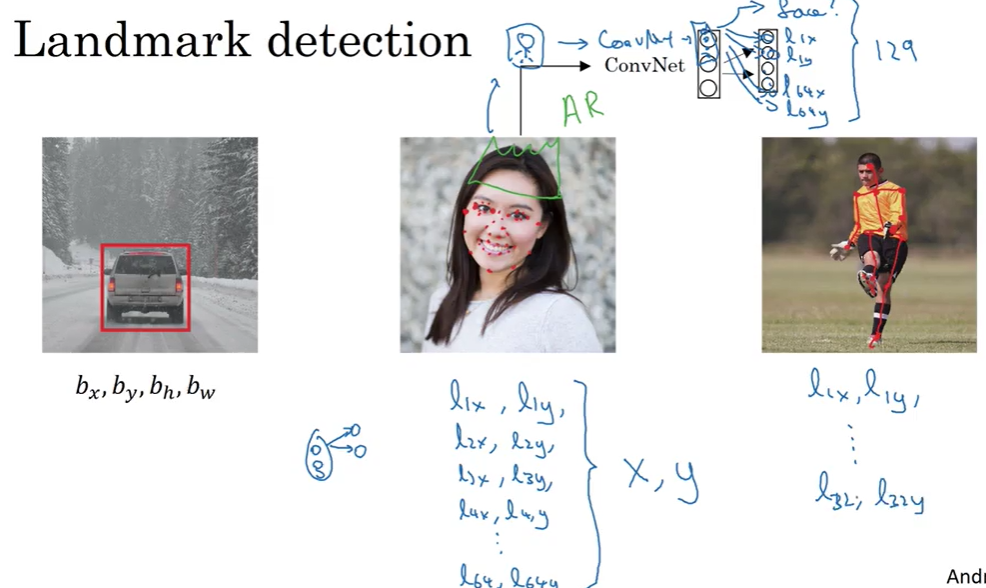



## 📦 Tools and Libraries

* **Dlib** – Classic face landmark detector
* **MediaPipe** – Real-time face/pose/hand landmark detection by Google
* **OpenCV** – For image preprocessing and visualization
* **PyTorch / TensorFlow** – For custom deep learning models


## 🎯 Challenges

* Requires **accurate labeled data**
* Sensitive to occlusion and lighting
* Must **generalize across variations** (e.g., faces at different angles)
* May need **face detection as a pre-step** to crop the region of interest


## Advanced Techniques

* **Heatmap-based regression** instead of direct coordinate regression
* **Attention mechanisms** to focus on key facial regions
* **Multi-task learning**: predict landmarks + emotions/attributes

# Sliding Window Object Detection

1. **Train a Classifier**

   * Build a labeled dataset with **closely cropped images** of objects (e.g., cars).
   * Each example is labeled with `y = 1` (contains object) or `y = 0` (does not).
   * Train a **ConvNet** to classify whether an image contains the object.

2. **Apply to Full Image with Sliding Window**

   * For a larger test image:

     * **Slide a fixed-size window** across the image (horizontally and vertically) with a chosen **stride**.
     * For each region (window):

       * Resize it to match the input size expected by the ConvNet.
       * Run the classifier.
       * Predict if that region contains the object (`0` or `1`).

3. **Repeat with Multiple Scales**

   * Run the sliding window process **at different window sizes (scales)**:

     * Helps detect **objects of varying sizes**.
     * For each scale, repeat the sliding window and prediction.

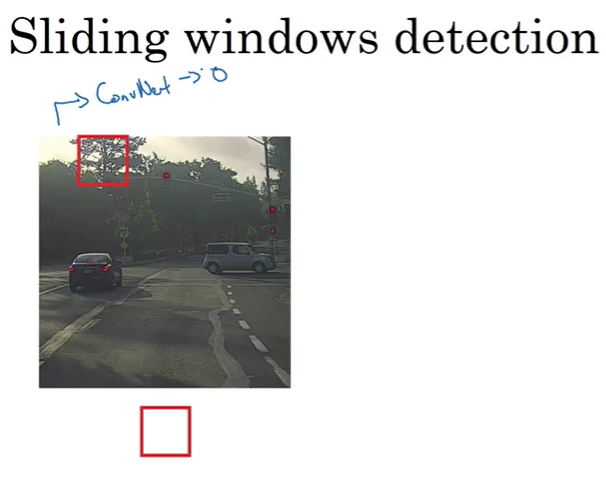


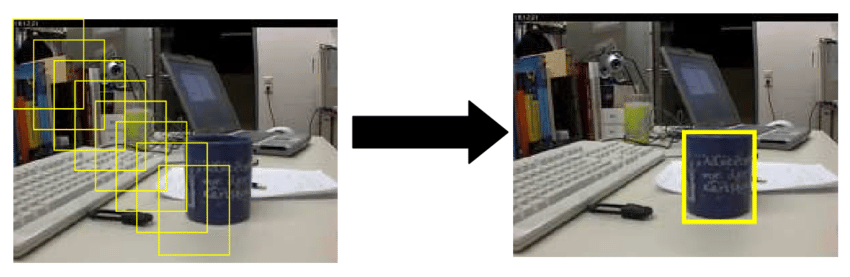

### Major Disadvantage:

* **Very computationally expensive** with ConvNets.

  * Each small region is passed **independently** through the network.
  * Huge number of regions to classify → **very slow** inference.


### Historical Context

* **Before deep learning**: sliding windows + simple classifiers (e.g., SVM + HOG features) worked well.
* **With ConvNets**: classification is slower → vanilla sliding window becomes **impractical**.


There’s a **better way** to use convolutional neural networks for object detection without cropping each region manually: **convolutional implementation of sliding windows**, which allows the network to efficiently process the entire image at once.

# Convolutional implementation of sliding windows

### Convert Fully Connected Layers into Convolutional Layers

This enables you to **run the ConvNet over the full image once** and get detection results for all windows.

Let’s break it down:

#### 1. **Example ConvNet (Original)**

* Input: **14×14×3**
* Conv Layer: 5×5 filters → **10×10×16**
* Max Pool: 2×2 → **5×5×16**
* Fully Connected: → 400 units → softmax with 4 classes (car, pedestrian, etc.)
* Output: **1×1×4**

#### 2. **Convert FC Layers to Convolutional Layers**

* FC layer (5×5×16 → 400) = **400 filters of size 5×5×16** → produces **1×1×400**
* Next FC layer = **1×1 conv with 400 filters** → still **1×1×400**
* Final layer: **1×1 conv with 4 filters** → **1×1×4**

💡 **Now all layers are convolutional**, so you can run them on *any size input*.

![image.png](attachment:ad0897d2-6b36-4785-b345-329c0ebcb767.png)


### 🖼️ Example: 16×16×3 Input

Instead of cropping 14×14 windows and running ConvNet 4 times:

* Input full 16×16 image
* Conv → MaxPool → Conv Layers → Output: **2×2×4**

  * Each **1×1×4** output corresponds to the class prediction for a 14×14 window:

    * Upper-left
    * Upper-right
    * Lower-left
    * Lower-right

You now **share computation across overlapping regions**, improving efficiency dramatically.

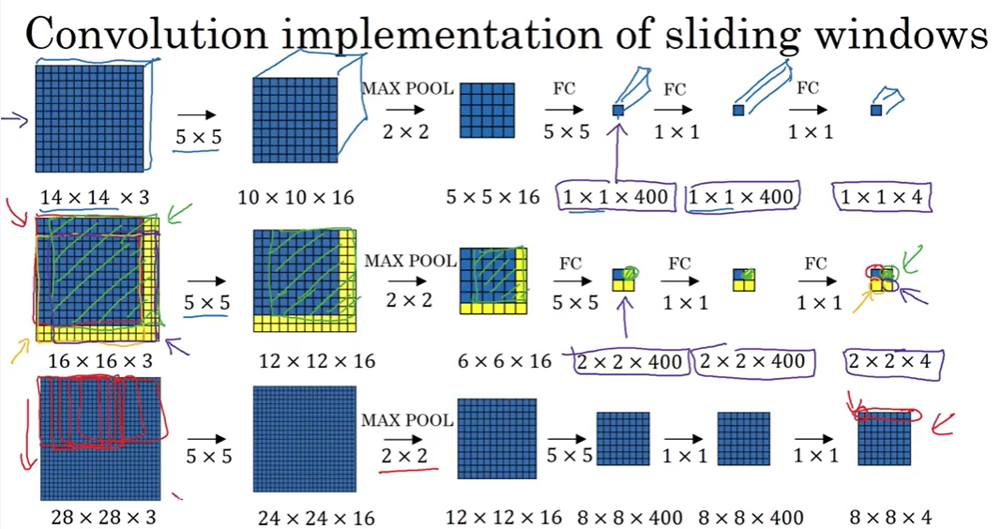


### 🔁 General Case: Larger Images

* Input: **28×28×3**
* Output after full pass: **8×8×4**

  * Each of the 64 positions is a classification for a different 14×14 region.
  * Done with **a single forward pass**!

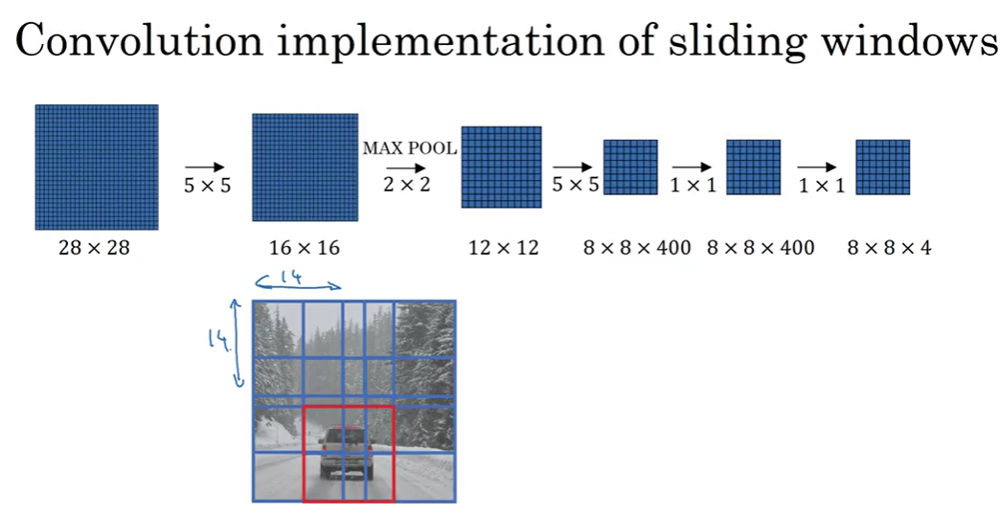


### Intuition

Instead of:

* Extract → Resize → Classify → Repeat

You:

* **Run one big convolutional forward pass**
* Get **multiple classifications at once**
* Exploit shared computations between overlapping windows


### Remaining Weakness

* This method gives **coarse bounding box positions** (e.g., 14×14 windows on 2-pixel stride)
* Still not very precise for localization.

# YOLO Algorithm for object detection

**YOLO** is a real-time object detection algorithm that frames object detection as a **regression** problem. It simultaneously predicts **multiple bounding boxes** and **class probabilities** from a single pass through a **convolutional neural network (CNN)**.

This is in contrast to older methods (like sliding windows or region proposals) that rely on **multiple steps** and are often slower and more complex.

* YOLO improves bounding box accuracy by reframing object detection as a **single regression problem**.
* It divides the image into a **grid** (e.g., 3×3 for illustration, 19×19 in practice).
* Each grid cell is responsible for detecting **objects whose midpoints fall inside it**.



The **core idea** of YOLO is:

> Divide the input image into a grid. Each grid cell is responsible for detecting objects whose centers fall inside that cell.

For each grid cell, YOLO predicts:

1. **Object presence (confidence score)**
2. **Bounding box coordinates (x, y, width, height)**
3. **Class probabilities**

### **Target Label Format (per grid cell):**

An 8-dimensional vector:

1. `P_c`: 1 if there's an object in the cell, else 0
2. `B_x, B_y`: Coordinates of the object center (relative to the grid cell)
3. `B_h, B_w`: Height and width of the bounding box (also relative to the grid cell)
4. `C_1, C_2, C_3`: One-hot encoded object class (e.g., pedestrian, car, motorcycle)

So the full output for a 3×3 grid becomes a **3×3×8** tensor.

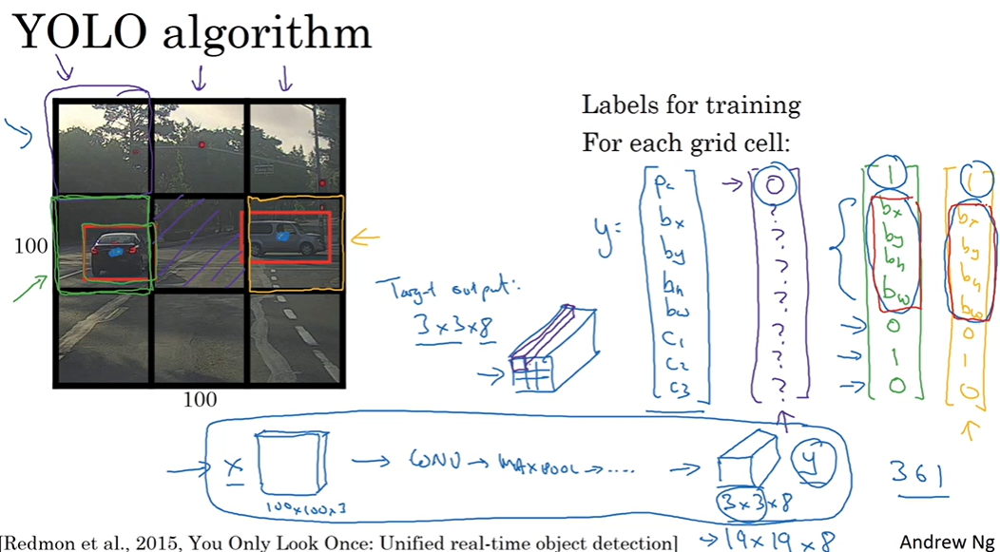



### **Bounding Box Parametrization:**

* `B_x`, `B_y` range from 0 to 1, denoting position within the grid cell.
* `B_h`, `B_w` can be >1, representing box size relative to grid cell size.
* More sophisticated parametrizations (e.g., sigmoid for centers, exp for size) can improve performance.

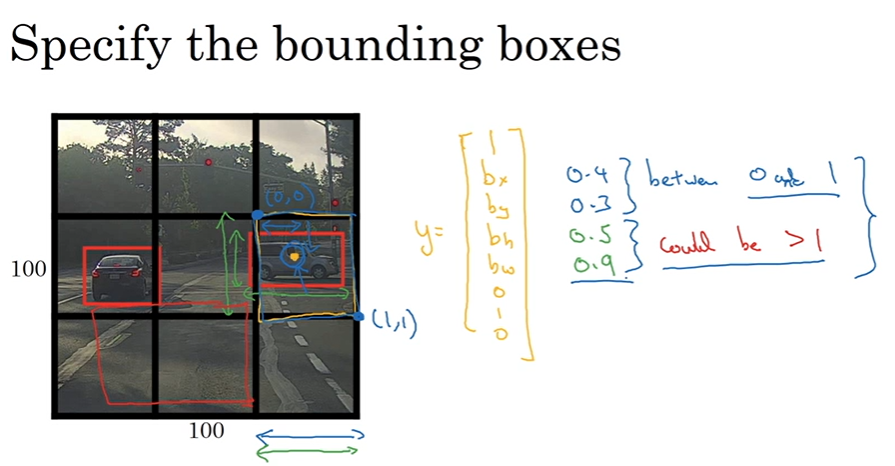


### Step-by-Step Architecture

Let's say our input image is **416×416×3** (standard size for YOLOv1).

### **1. Divide the Image into a Grid**

* Divide the image into an **S × S grid**.
* For YOLOv1, typically **S = 7**, so you get a 7×7 grid.
* Each grid cell is responsible for detecting objects whose **center** falls into it.

### **2. Predict Bounding Boxes and Classes Per Grid Cell**

Each grid cell predicts:

* **B bounding boxes**: For YOLOv1, B = 2

  * Each bounding box prediction contains:

    * `x, y`: center coordinates of the box relative to the grid cell (∈ \[0, 1])
    * `w, h`: width and height relative to the **whole image**
    * `confidence score`:

      * `P(object) × IOU(pred, truth)`
      * IOU = Intersection over Union between the predicted box and the ground truth

* **C class probabilities**:

  * These are conditioned on the object being present in the grid cell

### **3. Final Output Tensor Size**

If:

* `S = 7` (grid size)
* `B = 2` (bounding boxes per cell)
* `C = 20` (number of object classes, e.g., in Pascal VOC)

Then:

* Each grid cell outputs:
  `B × 5 + C = 2 × 5 + 20 = 30` values
* Total output size:
  `7 × 7 × 30 = 1470`


## 🧮 **What Do the Predictions Mean?**

* For each of the **S²** grid cells:

  * Each of the **B** bounding boxes outputs:

    * `x, y`: Center (as a fraction of the grid cell)
    * `w, h`: Width and height (relative to image)
    * `confidence`: How likely there is an object & how good the box is
  * One set of **C class probabilities**, shared by all B boxes

Then, **at inference time**, you combine:

* Confidence × Class probabilities → **Class-specific confidence scores**
* Apply **non-max suppression** to remove overlapping boxes


### **Training the Model**

### **Loss Function (YOLOv1)**:

YOLO uses a custom loss that combines:

1. **Localization loss** (for the box coordinates):

   * Only for the boxes responsible for detecting an object
   * Uses **squared error loss** for `x, y, w, h`
   * Takes square root of `w` and `h` to reduce impact of large boxes

2. **Confidence loss**:

   * Penalizes confidence scores for:

     * Boxes with no objects (should be 0)
     * Boxes with objects (should be IOU with ground truth)

3. **Classification loss**:

   * Only for the grid cells with objects
   * Uses squared error for class probabilities


## 🧪 **Inference (Prediction Time)**

1. Pass the image through the CNN to get the **S×S×(B×5+C)** output tensor
2. For each grid cell:

   * Multiply box confidence × class probabilities → class-specific scores
3. Keep boxes with **high scores**
4. Apply **Non-Max Suppression (NMS)** to eliminate duplicate detections


## 💡 **Why YOLO Works Well**

* **Speed**: Only one forward pass through the network
* **Global reasoning**: YOLO looks at the entire image at once (unlike region-based methods)
* **Compact architecture**: Fully convolutional and end-to-end trainable


## 🛠️ **Limitations in YOLOv1**

1. **Struggles with small objects**:

   * Especially when multiple small objects fall into one grid cell
2. **Poor localization**:

   * Coarse grid makes it hard to tightly fit bounding boxes
3. **Struggles with overlapping objects**:

   * One object per grid cell


## 🧬 **Evolution (YOLOv2, YOLOv3, YOLOv4, YOLOv5...)**

Later versions of YOLO introduced several improvements:

* **Anchor boxes**: Use predefined shapes and sizes for bounding boxes
* **Better backbones** (e.g., Darknet-19, Darknet-53, EfficientNet)
* **Multi-scale predictions**: Detect at multiple feature levels for better small-object detection
* **Improved loss functions**
* **Use of sigmoid and exponential transforms** for better bounding box stability











# Intersection over union metric

IoU is a metric that quantifies how much **overlap** there is between:

* the **predicted bounding box** (from your model), and
* the **ground truth bounding box** (the correct answer, usually hand-labeled).

### Definition:

$$
\text{IoU} = \frac{\text{Area of Overlap}}{\text{Area of Union}}
$$

* **Area of Overlap** = Intersection area (where predicted and ground truth boxes overlap)
* **Area of Union** = Total area covered by both boxes


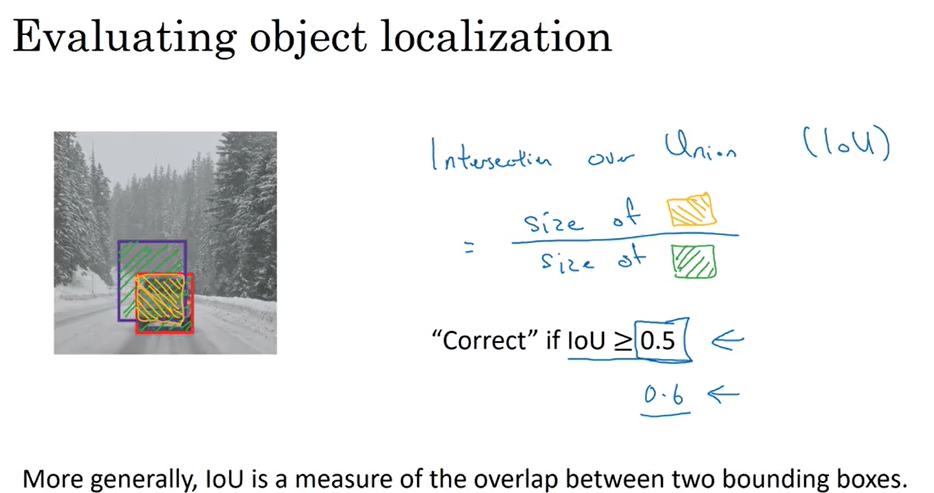


### Example:

Imagine a dog in an image. The ground-truth bounding box tightly surrounds the dog.

Now, say your model predicts a slightly off-center box.

* If the overlap between the two boxes is large, and they almost coincide → **IoU \~ 1**
* If there's only partial overlap → **IoU \~ 0.5**
* If they barely touch → **IoU < 0.2**
* No overlap → **IoU = 0**


### **When is a Detection Considered "Correct"?**

By **convention**, a predicted bounding box is said to be **correct** if:

$$
\text{IoU} \geq \text{Threshold}
$$

### Typical thresholds:

* **0.5** is a common choice (Pascal VOC standard)
* **0.75** is used for stricter evaluations (COCO metrics use multiple thresholds: 0.5 to 0.95)
* You can choose your own depending on your use case (e.g., 0.6 or 0.7 for high precision)


### Why is IoU Important?

1. **Localization accuracy**: IoU directly measures how well you localized the object.
2. **Evaluation**: Determines whether a prediction is a **True Positive**.
3. **Training**: Used in the loss function of newer YOLO versions (e.g., CIoU, GIoU) to guide the model.



### How IoU Affects Evaluation Metrics

IoU is used to classify predictions into categories:

| IoU ≥ threshold     | Prediction Count | Label          |
| ------------------- | ---------------- | -------------- |
| Yes                 | True Positive    | ✅ Correct      |
| No                  | False Positive   | ❌ Wrong box    |
| Missed ground truth | -                | False Negative |

From this, you calculate:

* **Precision**:

  $$
  \frac{\text{True Positives}}{\text{True Positives} + \text{False Positives}}
  $$

* **Recall**:

  $$
  \frac{\text{True Positives}}{\text{True Positives} + \text{False Negatives}}
  $$

* **mAP (mean Average Precision)**: Averaged precision across all classes, using IoU thresholds


### IoU in Post-Processing: Non-Max Suppression (NMS)

When YOLO (or any object detector) predicts multiple boxes for the same object, we use **NMS** to:

1. Select the box with the **highest confidence score**
2. Remove all **other boxes with high IoU** (i.e., overlapping) with that box
3. Repeat until no overlapping boxes are left above the IoU threshold

> So IoU is critical not only in **evaluating** model quality but also in **refining** predictions at inference time.


### Common Pitfalls

* **High classification accuracy doesn't mean high detection quality** if IoU is poor.
* A model can detect the **right class** but with a **bad box** → penalized by low IoU.
* Choosing **IoU threshold too low** can lead to false positives being marked correct.

# Non max suppression

In object detection (like YOLO), multiple grid cells might **detect the same object multiple times**, leading to **duplicate predictions** for one object.


NMS is a **post-processing step** used to eliminate duplicate detections and keep only the **most confident** bounding box per object.


### **How Non-Max Suppression Works:**

1. **Filter out low-confidence boxes:**
   Discard all predicted boxes with objectness score (Pc) ≤ a chosen threshold (e.g. 0.6).

2. **While there are remaining boxes:**

   * **Pick the box with the highest confidence** (Pc).
   * **Output it as a detection.**
   * **Suppress all other boxes** that have a high **IoU** (overlap) with it (e.g. IoU ≥ 0.5).

     * These are likely duplicate detections of the same object.

3. **Repeat** until all boxes are either kept or suppressed.


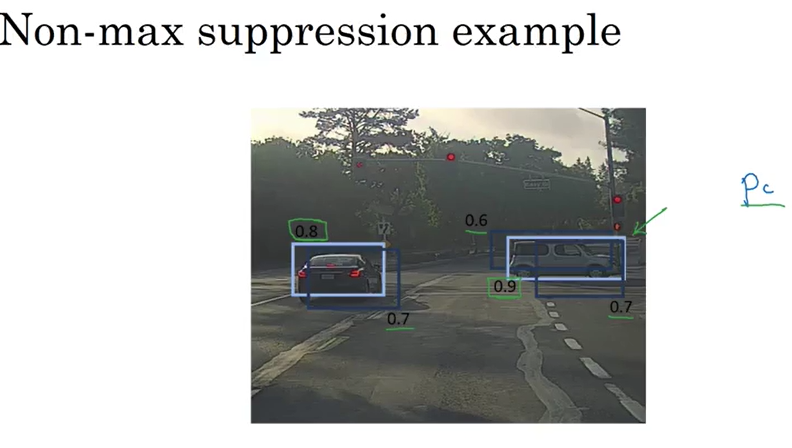


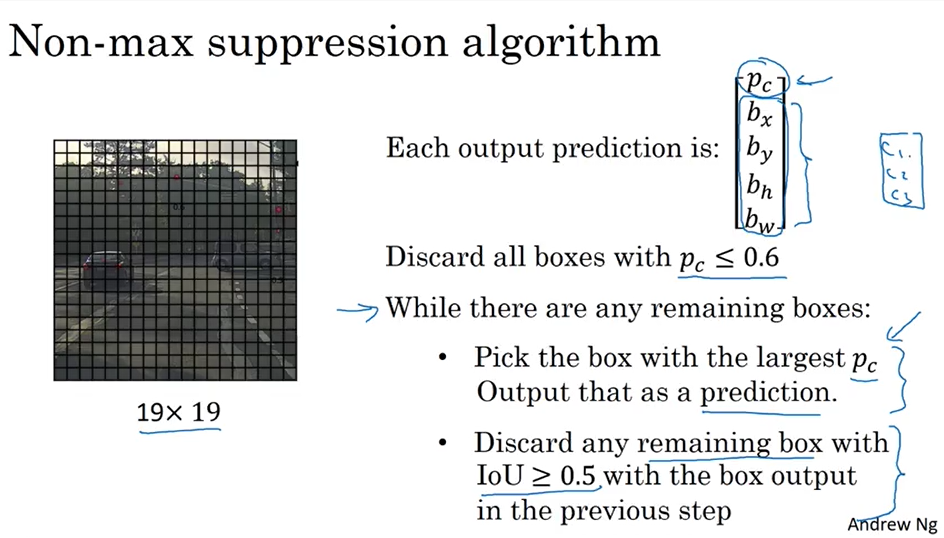


### Output Example:

If several boxes overlap around a car:

* Pick the one with highest Pc (say 0.9).
* Suppress nearby boxes with lower Pc but high IoU (say 0.7 and 0.6).
* Then repeat for the next most confident non-overlapping box (say 0.8).

You’re left with **one bounding box per object**.


### Applied to Multi-Class Detection:

* When detecting multiple classes (e.g. cars, pedestrians, motorcycles):

  * Run **Non-Max Suppression separately for each class**.


### Key Idea:

NMS = Keep only the **maximum confidence** detection and **suppress non-max** (overlapping) ones → "Non-Max Suppression".

# Anchor Boxes

In basic object detection (e.g. YOLO), **each grid cell can detect only one object**.
But what if **multiple objects** (e.g. a pedestrian and a car) have **midpoints in the same grid cell**?
→ The model can’t represent both with a single output.

**Anchor boxes** (also called **prior boxes**) let each grid cell detect **multiple objects with different shapes**.


### **How It Works:**

1. **Predefine a set of anchor box shapes** (e.g. 2 or more).

   * Example: A tall rectangle (for pedestrians), a wide rectangle (for cars).

2. **For each grid cell**, the network outputs **one prediction per anchor box**.

   * So if you have 2 anchor boxes and 3 classes, each grid cell outputs:
     `2 × (Pc, bx, by, bh, bw, C1, C2, C3) = 2 × 8 = 16 values`

3. **Training labels (Y)** are assigned by:

   * Finding the grid cell containing the object’s center.
   * Among that cell’s anchor boxes, choosing the one with **highest IoU** with the object’s shape.

4. The output tensor becomes:

   * For a 3×3 grid, 2 anchors per cell → `3 × 3 × 2 × 8 = 144 values`.



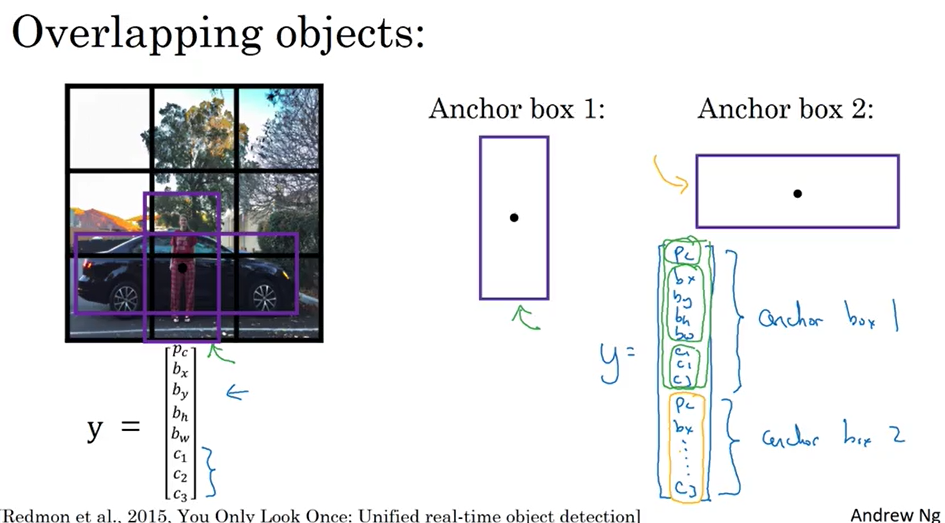

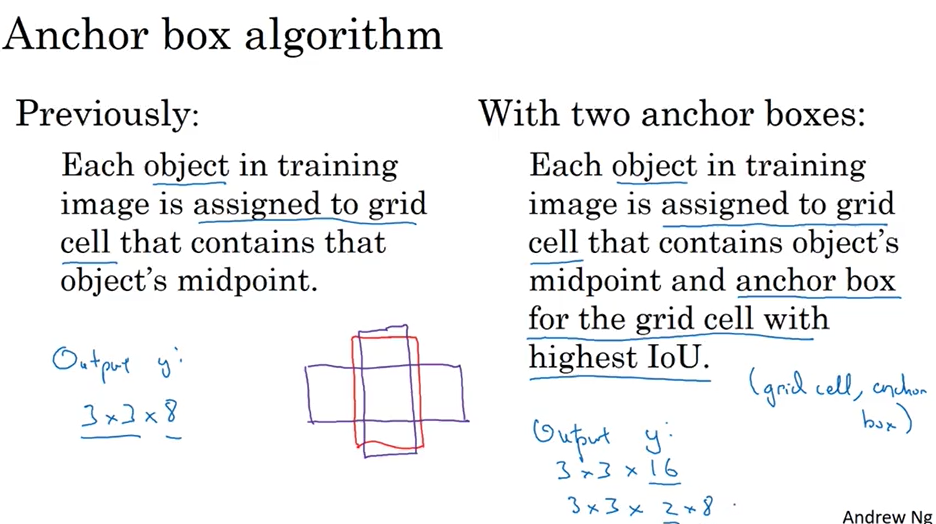

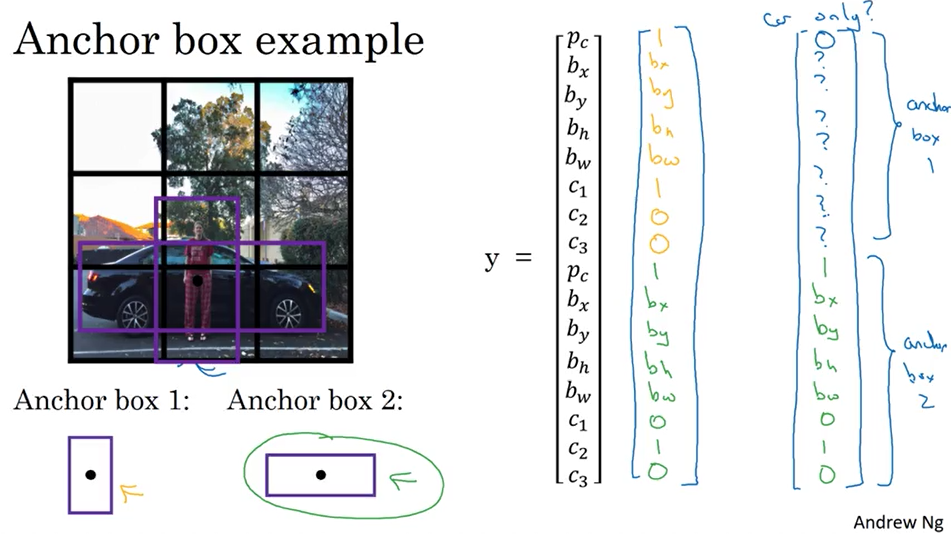


### Example:

* One grid cell contains both a **pedestrian** and a **car**.

  * Assign **anchor box 1** (tall) to the pedestrian.
  * Assign **anchor box 2** (wide) to the car.
  * Each anchor box outputs its respective detection.


### Limitations:

* If **more objects** exist in one cell than anchor boxes → cannot represent all.
* If **two objects** best match the **same anchor box shape** → conflict, fallback needed.
* But these cases are rare, especially with fine grids (e.g. 19×19).


### **Bonus Benefit: Specialization**

Even beyond handling multiple objects per cell, **anchor boxes help the model specialize**:

* Some output units learn to detect **tall objects** (like people),
* Others learn **wide objects** (like cars).


### How to Choose Anchor Boxes:

* Manually: Pick 5–10 box shapes of various aspect ratios and sizes.
* Automatically: Use **K-means clustering** on bounding box dimensions in your training set (used in later YOLO versions).

# YOLO Algorithm


### **1. Constructing the Training Set**

* **Object Classes**: For example — pedestrians, cars, motorcycles.

* **Anchor Boxes**: Use 2 anchor boxes → for different object shapes.

* **Output Format**:

  * Each grid cell outputs `2 × 8 = 16` values (Pc + bbox + 3 class scores).
  * For a 3×3 grid → `3 × 3 × 16` output tensor.
  * More generally: `S × S × (num_anchors × (5 + num_classes))`

* **Label Assignment**:

  * For each object in the image:

    * Find the grid cell containing the object’s **center**.
    * Find the **anchor box** (in that cell) with the **highest IoU**.
    * Assign the object’s info to that anchor box’s slot.
  * If no object in a grid cell → set `Pc = 0` for both anchor boxes, rest = don’t care.


### **2. Model Architecture**

* Input: Image (e.g., 100×100×3).
* Backbone: Convolutional neural network (e.g., a CNN or ResNet).
* Output: Grid-shaped tensor, e.g.:

  * `3 × 3 × 16` (if 3×3 grid and 2 anchors)
  * `19 × 19 × 40` (if 19×19 grid and 5 anchors)


### **3. Making Predictions**

* Output is interpreted similarly to training labels.

  * For each grid cell and anchor box:

    * Predict objectness (Pc)
    * Predict bounding box (bx, by, bh, bw)
    * Predict class probabilities (C1, C2, C3)

* If `Pc` is low → treat prediction as background.


### **4. Postprocessing with Non-Max Suppression (NMS)**

1. **Generate Predictions**:

   * Get all predicted boxes (anchor box per grid cell).
2. **Filter Low-Confidence Boxes**:

   * Remove predictions where `Pc` is below a threshold.
3. **Run NMS for Each Class**:

   * For pedestrians, cars, motorcycles → **independently run NMS** to eliminate overlapping boxes and keep the best.


### Key Advantages of YOLO:

* Fast and unified end-to-end architecture.
* Uses **anchor boxes** for detecting multiple object shapes per grid cell.
* **Postprocessing** (NMS) helps clean overlapping predictions.
* Scalable to many object classes and real-time applications.

# Region proposals (R-CNN)

### **The Problem with Sliding Windows**

* Traditional sliding window approaches classify all possible regions across an image — **inefficient** and **wastes compute** on clearly empty areas.
* Example: Running classification on blank areas of the image where there's obviously no object.


### **The Region Proposal Idea (R-CNN)**

* **Proposed by:** Ross Girshick, Jeff Donahue, Trevor Darrell, and Jitendra Malik.
* **R-CNN = Regions with CNN features**
* Instead of scanning the entire image:

  * Use a **segmentation algorithm** to propose \~2000 *candidate regions* (blobs).
  * Run a CNN classifier only on those selected regions.
  * Also refine the **bounding box** (bx, by, bh, bw) per region to improve accuracy.

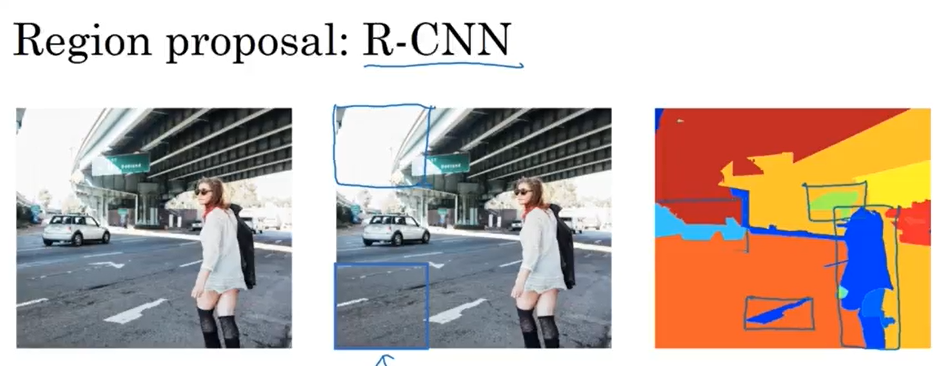


### **Downside of R-CNN**

* Still **slow**:

  * Region proposals done with a separate algorithm (non-learned).
  * CNN is run **individually** on each proposed region → computationally expensive.


### **Fast R-CNN**

* **Improves speed** by:

  * Running the CNN **once** over the full image.
  * Using the shared CNN feature map to classify each proposed region (instead of processing each region separately).

* But still uses the **slow external region proposal step**.


### **Faster R-CNN**

* **Proposes regions using a CNN**, not a traditional algorithm.

* Introduces the **Region Proposal Network (RPN)**:

  * Learns to propose likely object regions using convolutional features.
  * Fully integrated into the model → end-to-end training possible.

* **Much faster** than R-CNN and Fast R-CNN, but still generally **slower than YOLO**.


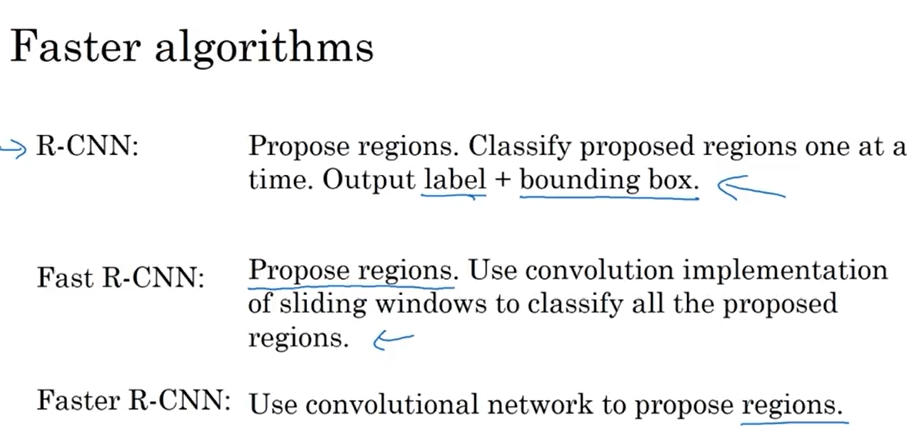


### Final Thoughts

* Region proposal methods (especially R-CNNs) have been influential historically.
* However, modern trends (e.g., YOLO, SSD, DETR) prefer **end-to-end, unified detection** without a separate region proposal step for **speed and simplicity**.
* Still important to learn R-CNNs to understand older or current research that uses them.

# Semantic Segmentation

* **Object Recognition**: What is in the image? (e.g., cat vs. not-cat)
* **Object Detection**: Where is the object? (bounding boxes)
* **Semantic Segmentation**: Which **pixels** belong to which object? (per-pixel classification)

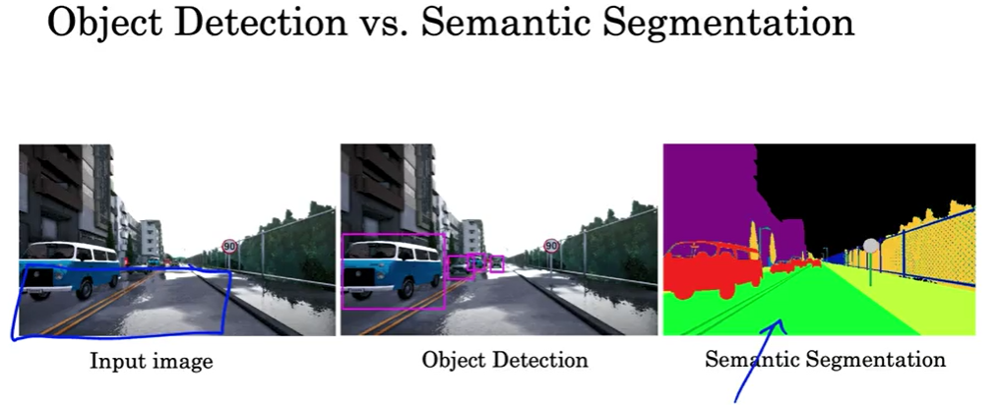


* Assigns a **class label to each pixel** of the image.
* Useful for:

  * **Self-driving cars**: Detect drivable areas, pedestrians, vehicles at pixel level.
  * **Medical imaging**: Segment organs or tumors (e.g., lungs, heart, brain tumor) for diagnosis and surgical planning.

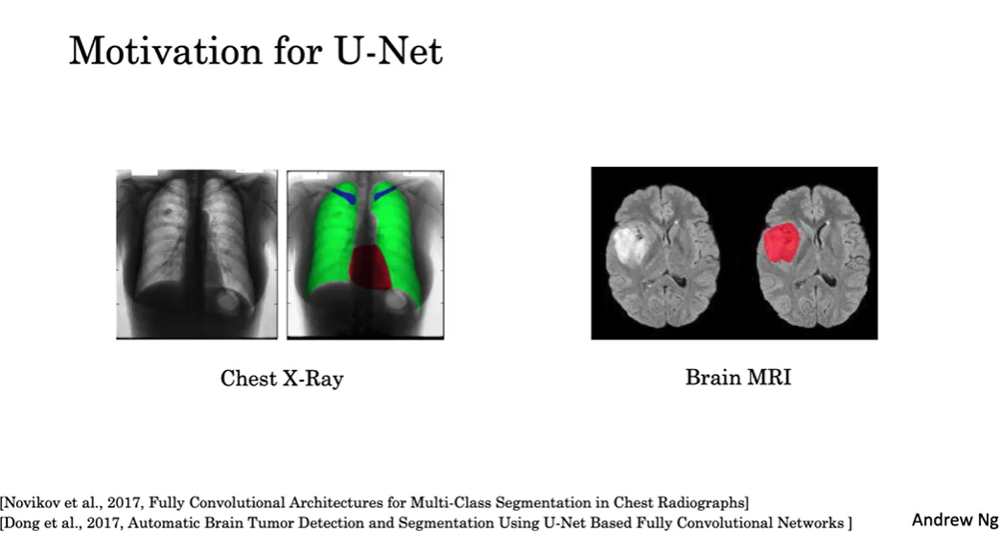


### **Output**

* A full-sized matrix (same dimensions as input image) with class labels per pixel.

  * Example:

    * `1` = car
    * `2` = building
    * `3` = road
* Much more detailed than bounding boxes.


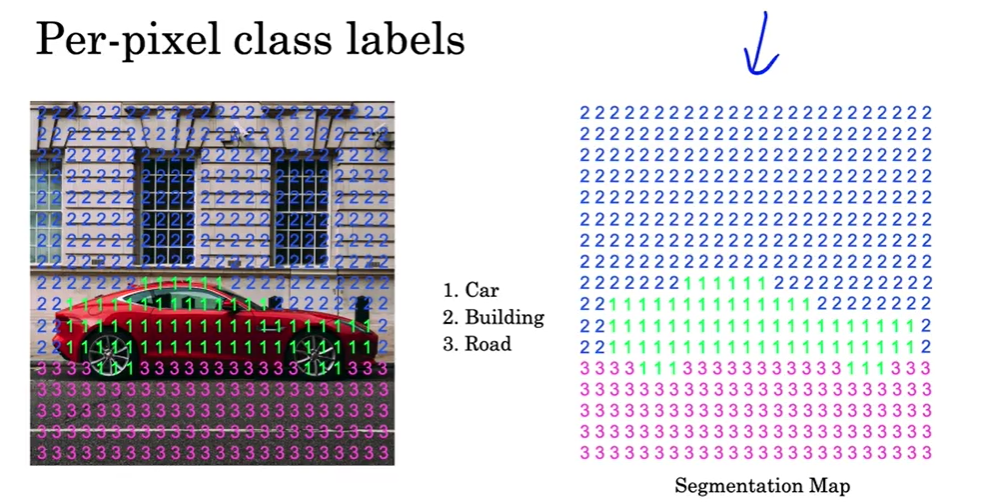

### **Architecture: From CNN to U-Net**

* Standard CNN shrinks the image spatially (width/height ↓, channels ↑).
* **U-Net architecture**:

  * Downsamples input (encoder).
  * **Upsamples** it back to full resolution (decoder).
  * Outputs a **segmentation map**.
  * Uses **transpose convolutions** to increase spatial dimensions.


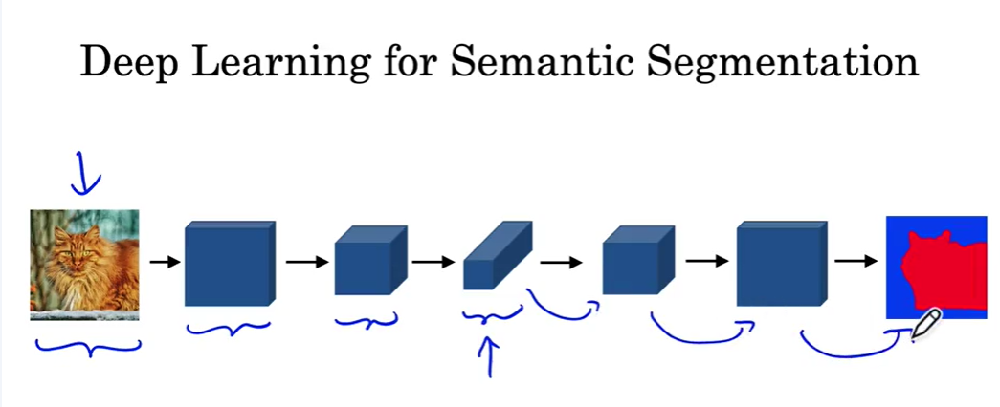

### **Key Concept: Transpose Convolution**

* Also called "deconvolution" or "upsampling with learned weights."
* Used to **increase resolution** of feature maps in decoder stages of U-Net.



# Tranpose Convolution

* A method to **upsample** (increase) the spatial dimensions of an input.
* Also called:

  * **Deconvolution**
  * **Upconvolution**
* Used to convert a small activation map (e.g. 2×2) into a larger one (e.g. 4×4).


### **How Does It Work?**

1. **Start** with a small input (e.g. a 2×2 grid of numbers).
2. **Apply a filter** (e.g. 3×3) to each input element.
3. Each input element is:

   * Multiplied with the filter.
   * The result is "pasted" into a specific part of the output.
4. **Stride** controls how far apart the "pasted" patches are.
5. **Overlaps** in patches are **added together**, not overwritten.


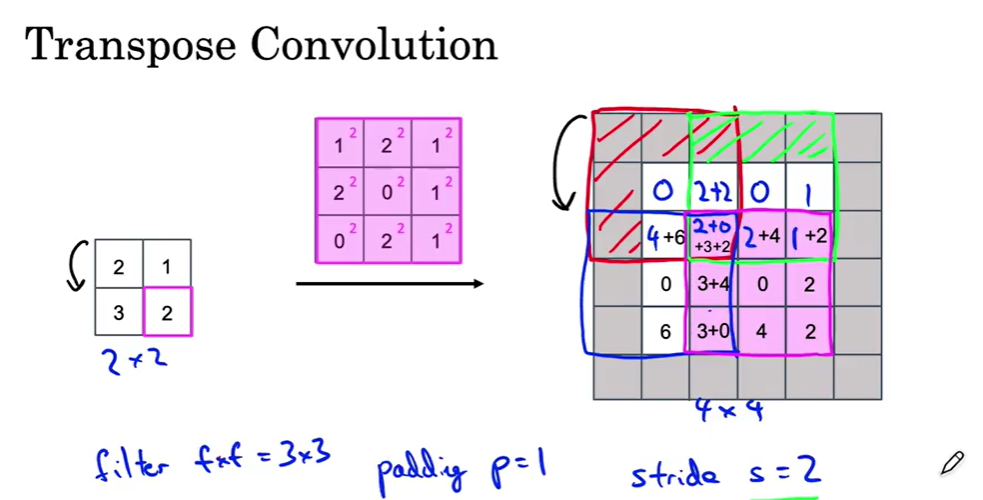

### **Example**

* Input: 2×2 grid
* Filter: 3×3
* Stride: 2
* Padding: 1
* Each input value (e.g. 2, 1, 3, 2) is multiplied with the full filter.
* Output: 4×4 grid is formed by **adding overlapping regions** from each input element's filter application.


### **Why This Approach?**

* There are many ways to expand small inputs into larger outputs.
* **Transpose convolution** is:

  * **Learnable** (filters are trained by the model).
  * **Effective** in practice.
  * Essential for tasks like **semantic segmentation**, where spatial detail matters.


### **In the U-Net**

* Transpose convolutions are used in the **upsampling path** (decoder) of U-Net.
* They help build the final **segmentation map** that matches the input size.

# U-Net architecture

* **U-Net** is a specialized convolutional neural network architecture, primarily designed for **semantic segmentation**.
* Named **U-Net** because its shape, when drawn, resembles the letter “U”.

## Intuition

### **Downsampling Path (Encoder)**

* The first part of the network uses **standard convolutions**.
* This compresses the image into a **smaller spatial representation** but with **more channels** (i.e., deeper feature maps).
* The output contains **high-level contextual features**, e.g., recognizing that a “cat” is roughly in a certain area—but with **low spatial detail**.

### 🔺 **Upsampling Path (Decoder)**

* The second part uses **transpose convolutions** to **expand** the feature maps back to the original image size.
* Alone, this upsampling loses **fine-grained detail**.

### **Skip Connections (Key U-Net Innovation)**

* To solve the loss of detail, **skip connections** are added from early layers to their corresponding later layers.
* These skip connections bring in **high-resolution, low-level features** (e.g., texture, edges) from the encoder.
* The decoder layer then uses **both**:

  * **High-level context** (from compressed features),
  * **Fine spatial detail** (from early layers),
  * Which improves **pixel-level classification** (e.g., detecting exact cat boundaries).

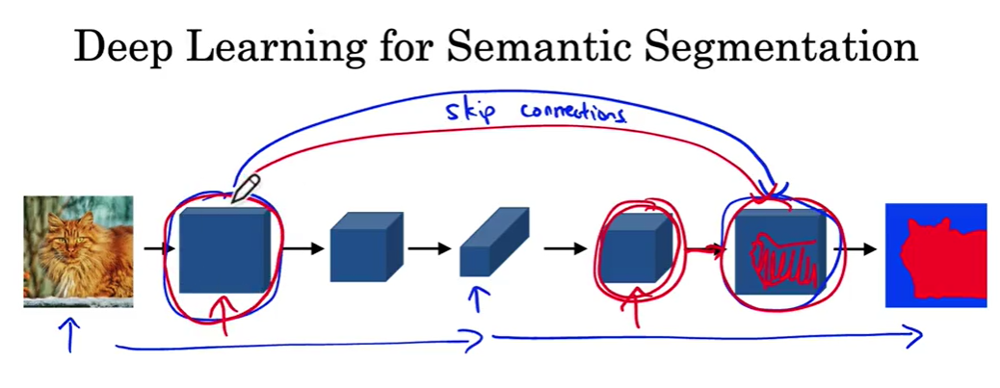


## Full Architecture

### **Input**

* The input is an image of size **H × W × 3** (RGB).
* For simplicity, layers are visualized as **2D rectangles** in diagrams (ignoring depth in the drawing).


### **Encoder (Left Half – Contracting Path)**

* Uses **standard convolutional layers** with **ReLU** activation functions (black arrows).
* Followed by **max pooling** layers to reduce spatial resolution (height & width).
* As we go deeper:

  * Spatial dimensions decrease,
  * Feature depth (channels) increases.
* This part **extracts abstract, high-level features** while compressing spatial information.

### **Decoder (Right Half – Expanding Path)**

* Uses **transpose convolutions** (green arrows) to **upsample** and reconstruct the spatial resolution.
* After each transpose convolution, **skip connections** (gray arrows) are used:

  * They **copy corresponding feature maps** from the encoder to the decoder.
  * This merges **contextual info (from decoder)** with **fine details (from encoder)**.
* Followed by regular convolutions (black arrows again) to refine the features after merging.


### **Final Output**

* Ends with a **1×1 convolution** (magenta arrow) to produce the **segmentation map**.
* Output shape: **H × W × num\_classes**.

  * For each pixel, it predicts class probabilities.
  * **Argmax** over the class dimension gives the final pixel-wise class label.
* Example: If you’re segmenting 3 classes, each pixel has a 3-element vector of probabilities.


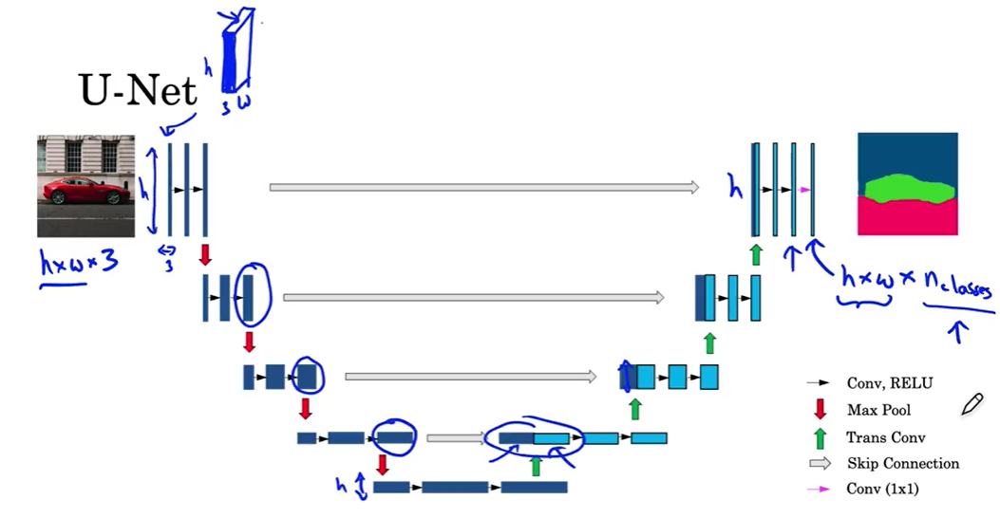